<a href="https://colab.research.google.com/github/lblabucsd/Zada_Schulze_24/blob/main/dc_neural_analysis_schooling_cells.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This code is for combine and analysis the 2p imaging and schooling stimuli/behavior done with the bonsai workflow

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

#load packages
!pip install pynrrd
!pip install scikit-posthocs

import os
import csv
import numpy as np
import pandas as pd
import math
import time
import json
import matplotlib as mpl
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import animation
import nrrd
import scipy
from scipy import io
from scipy.fftpack import rfft, irfft, fftfreq
import scipy.stats as stats
import statsmodels
import seaborn as sns
from sklearn.decomposition import PCA, FastICA
from sklearn.cluster import KMeans, AgglomerativeClustering
import random
from random import randrange
from random import shuffle
import sklearn
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix, accuracy_score
import itertools
import scikit_posthocs as sp
import statsmodels.api as sm
import statsmodels.formula.api as smf
import statsmodels.stats.multitest as multi
from statsmodels.formula.api import ols
from statsmodels.stats.anova import anova_lm
from statsmodels.stats.multicomp import pairwise_tukeyhsd
import warnings
warnings.simplefilter('ignore')
%matplotlib inline
sns.set_style("white")


def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return idx

def running_mean(x, N):
    return np.convolve(x, np.ones((N,))/N)[(N-1):]

def norm(inputs):
    output = (inputs-min(inputs))/(max(inputs)-min(inputs))
    return output

def baseline_subtraction(angle, window):
    new=[]
    for ndx,i in enumerate(angle):
        if ndx<window/2 or ndx>len(angle)-window/2:
            new.append(0)
        else:
            baseline=np.median(angle[ndx-int(window/2):ndx+int(window/2)])
            new.append(i-baseline)
    return new

def resized(data,N):
    old_indices = np.linspace(0, len(data) - 1, len(data))
    new_indices = np.linspace(0, len(data) - 1, N)
    res = np.interp(new_indices, old_indices, data)
    return res

import matplotlib as mpl
from matplotlib import pyplot as plt
import matplotlib.animation as animation
from mpl_toolkits.axes_grid1 import make_axes_locatable
from mpl_toolkits.mplot3d import Axes3D
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42

sns.set(font_scale=3)
sns.set_style("white")

figure_savepath = '/content/drive/MyDrive/Zada_Schulze_paper/Figures_output/Neural_activity/'

print("S1 = horizontal object stimulus")
print("S2 = vertical object stimulus")
print("S3 = circle object stimulus")
print("S4 = floor drift stimulus")

Mounted at /content/drive/
S1 = horizontal object stimulus
S2 = vertical object stimulus
S3 = circle object stimulus
S4 = floor drift stimulus


['telencephalon', 'dorsal_forebrain', 'ventral_forebrain']
DZ-230518_wk2_f1_z-130_schooling
DZ-230605-f3-100_2wk_schooling
DZ-230605-f5-90_2wk_schooling
ml-230427-f4_schooling-3
DZ-230517_wk2_f2-2_schooling
DZ-230518_wk2_f2-170_schooling
DZ-230503_wk4_f1_schooling
DZ-230519_wk4_f1-2_schooling
DZ-230523_wk4_f2_-140_schooling
DZ-230427_wk4_f1_schooling
DZ-230522-f2-120_4wk_schooling
DZ-230523_wk4_f1_-110_schooling
DZ-230523_wk4_f4_-90_schooling
DZ-230522_wk6_f3_schooling
DZ-230522_wk6_f2_schooling
DZ-230521_wk6_f4_schooling
DZ-230529_wk6_f1_-160_schooling
DZ-230524_wk6_f1-3_schooling
DZ-230503_wk6_f1_schooling
DZ-230525-f1-130_6wk_schooling
DZ-230521_wk6_f2-140_schooling
number of  cells in telencephalon


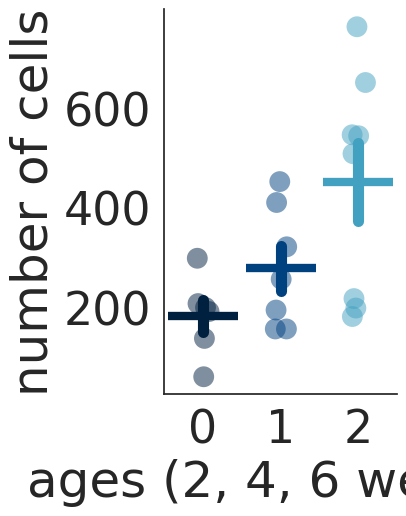

statistics for comparison: Kruskal-Wallis test with posthoc Dunns comparison (bonferroni corrected)
H-statistic:  5.963210495374244 P-value:  0.05071136419281025
max zscore for cells in telencephalon


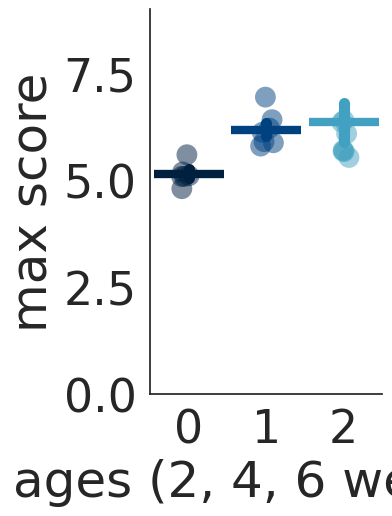

statistics for comparison: Kruskal-Wallis test with posthoc Dunns comparison (bonferroni corrected)
H-statistic:  12.232065553494138 P-value:  0.002207195052156491
          wk2       wk4       wk6
wk2  1.000000  0.002658  0.017991
wk4  0.002658  1.000000  1.000000
wk6  0.017991  1.000000  1.000000
shape of data is 
(6,)
(7,)
(8,)
['dienencephalon', 'habenula', 'thalamus']
DZ-230518_wk2_f1_z-130_schooling
DZ-230605-f3-100_2wk_schooling
DZ-230605-f5-90_2wk_schooling
ml-230427-f4_schooling-3
DZ-230517_wk2_f2-2_schooling
DZ-230518_wk2_f2-170_schooling
DZ-230503_wk4_f1_schooling
DZ-230519_wk4_f1-2_schooling
DZ-230523_wk4_f2_-140_schooling
DZ-230427_wk4_f1_schooling
DZ-230522-f2-120_4wk_schooling
DZ-230523_wk4_f1_-110_schooling
DZ-230523_wk4_f4_-90_schooling
DZ-230522_wk6_f3_schooling
DZ-230522_wk6_f2_schooling
DZ-230521_wk6_f4_schooling
DZ-230529_wk6_f1_-160_schooling
DZ-230524_wk6_f1-3_schooling
DZ-230503_wk6_f1_schooling
DZ-230525-f1-130_6wk_schooling
DZ-230521_wk6_f2-140_schooling
numbe

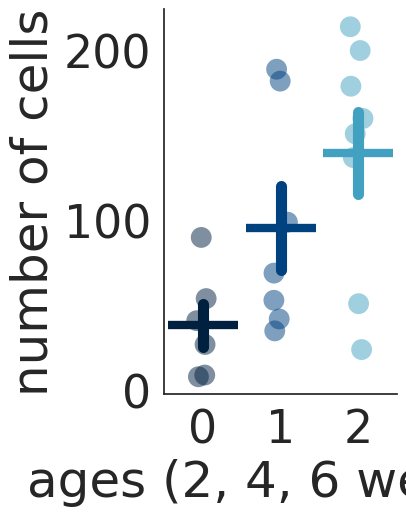

statistics for comparison: Kruskal-Wallis test with posthoc Dunns comparison (bonferroni corrected)
H-statistic:  6.447742733457034 P-value:  0.0398006766042876
          wk2       wk4       wk6
wk2  1.000000  0.265362  0.036046
wk4  0.265362  1.000000  1.000000
wk6  0.036046  1.000000  1.000000
max zscore for cells in dienencephalon


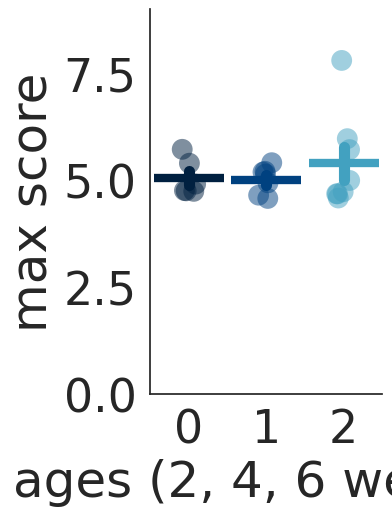

statistics for comparison: Kruskal-Wallis test with posthoc Dunns comparison (bonferroni corrected)
H-statistic:  0.072356215213361 P-value:  0.9644684990085487
shape of data is 
(6,)
(7,)
(8,)
['mesencephalon', 'left_tectum_neuropil', 'left_tectum_cell-layer', 'right_tectum_neuropil', 'right_tectum_cell-layer']
DZ-230518_wk2_f1_z-130_schooling
DZ-230605-f3-100_2wk_schooling
DZ-230605-f5-90_2wk_schooling
ml-230427-f4_schooling-3
DZ-230517_wk2_f2-2_schooling
DZ-230518_wk2_f2-170_schooling
DZ-230503_wk4_f1_schooling
DZ-230519_wk4_f1-2_schooling
DZ-230523_wk4_f2_-140_schooling
DZ-230427_wk4_f1_schooling
DZ-230522-f2-120_4wk_schooling
DZ-230523_wk4_f1_-110_schooling
DZ-230523_wk4_f4_-90_schooling
DZ-230522_wk6_f3_schooling
DZ-230522_wk6_f2_schooling
DZ-230521_wk6_f4_schooling
DZ-230529_wk6_f1_-160_schooling
DZ-230524_wk6_f1-3_schooling
DZ-230503_wk6_f1_schooling
DZ-230525-f1-130_6wk_schooling
DZ-230521_wk6_f2-140_schooling
number of  cells in mesencephalon


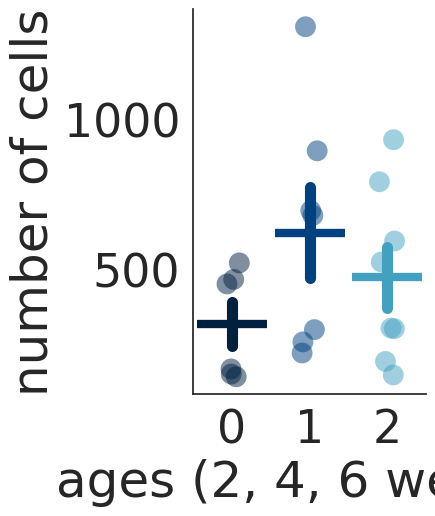

statistics for comparison: Kruskal-Wallis test with posthoc Dunns comparison (bonferroni corrected)
H-statistic:  3.2487631416202873 P-value:  0.19703348879462154
max zscore for cells in mesencephalon


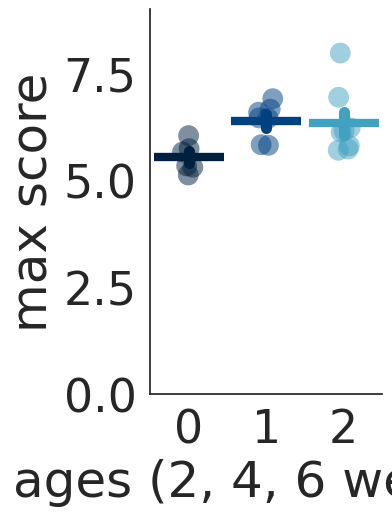

statistics for comparison: Kruskal-Wallis test with posthoc Dunns comparison (bonferroni corrected)
H-statistic:  9.348948670377254 P-value:  0.009330428526797439
          wk2       wk4       wk6
wk2  1.000000  0.009472  0.064292
wk4  0.009472  1.000000  1.000000
wk6  0.064292  1.000000  1.000000
shape of data is 
(6,)
(7,)
(8,)
['rhombencephalon', 'cerebellum', 'hindbrain']
DZ-230518_wk2_f1_z-130_schooling
DZ-230605-f3-100_2wk_schooling
DZ-230605-f5-90_2wk_schooling
ml-230427-f4_schooling-3
DZ-230517_wk2_f2-2_schooling
DZ-230518_wk2_f2-170_schooling
DZ-230503_wk4_f1_schooling
DZ-230519_wk4_f1-2_schooling
DZ-230523_wk4_f2_-140_schooling
DZ-230427_wk4_f1_schooling
DZ-230522-f2-120_4wk_schooling
DZ-230523_wk4_f1_-110_schooling
DZ-230523_wk4_f4_-90_schooling
DZ-230522_wk6_f3_schooling
DZ-230522_wk6_f2_schooling
DZ-230521_wk6_f4_schooling
DZ-230529_wk6_f1_-160_schooling
DZ-230524_wk6_f1-3_schooling
DZ-230503_wk6_f1_schooling
DZ-230525-f1-130_6wk_schooling
DZ-230521_wk6_f2-140_schooling
nu

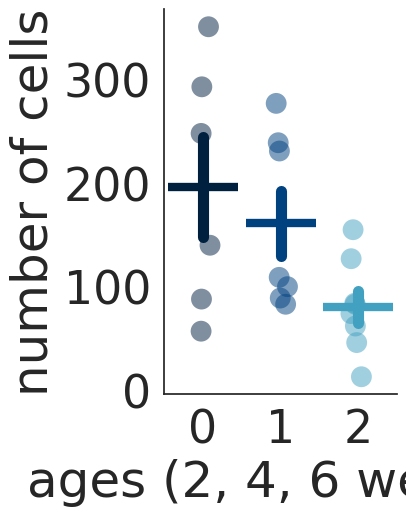

statistics for comparison: Kruskal-Wallis test with posthoc Dunns comparison (bonferroni corrected)
H-statistic:  5.990477737553763 P-value:  0.05002467632606342
max zscore for cells in rhombencephalon


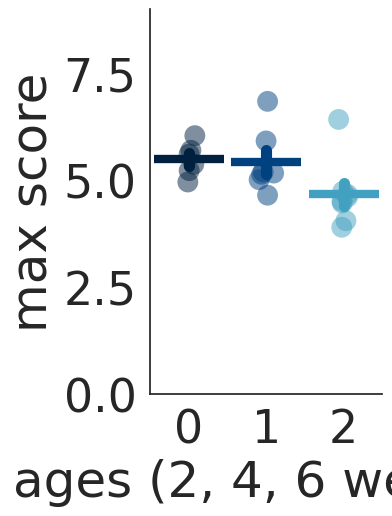

statistics for comparison: Kruskal-Wallis test with posthoc Dunns comparison (bonferroni corrected)
H-statistic:  7.909090909090921 P-value:  0.019167379014848968
         wk2       wk4       wk6
wk2  1.00000  1.000000  0.027070
wk4  1.00000  1.000000  0.106674
wk6  0.02707  0.106674  1.000000
shape of data is 
(6,)
(7,)
(8,)


In [ ]:
#get plots of simple metrics (# of cells per region, max dF/F, standard deviation)

wk2_subjects = [
'DZ-230518_wk2_f1_z-130_schooling',
'DZ-230605-f3-100_2wk_schooling',
'DZ-230605-f5-90_2wk_schooling',
'ml-230427-f4_schooling-3',
'DZ-230517_wk2_f2-2_schooling',
'DZ-230518_wk2_f2-170_schooling']

wk4_subjects=[
'DZ-230503_wk4_f1_schooling',
'DZ-230519_wk4_f1-2_schooling',
'DZ-230523_wk4_f2_-140_schooling',
'DZ-230427_wk4_f1_schooling',
'DZ-230522-f2-120_4wk_schooling',
'DZ-230523_wk4_f1_-110_schooling',
'DZ-230523_wk4_f4_-90_schooling']

wk6_subjects=[
'DZ-230522_wk6_f3_schooling',
'DZ-230522_wk6_f2_schooling',
'DZ-230521_wk6_f4_schooling',
'DZ-230529_wk6_f1_-160_schooling',
'DZ-230524_wk6_f1-3_schooling',
'DZ-230503_wk6_f1_schooling',
'DZ-230525-f1-130_6wk_schooling',
'DZ-230521_wk6_f2-140_schooling']

subjects = wk2_subjects+wk4_subjects+wk6_subjects


brain_regions = ['dorsal_forebrain', 'ventral_forebrain', 'habenula','thalamus',\
                 'left_tectum_neuropil', 'left_tectum_cell-layer',\
                 'right_tectum_neuropil', 'right_tectum_cell-layer',\
                 'cerebellum', 'hindbrain']

brain_region_groupings = [['telencephalon', 'dorsal_forebrain', 'ventral_forebrain'],\
                          ['dienencephalon', 'habenula','thalamus'],\
                          ['mesencephalon', 'left_tectum_neuropil', 'left_tectum_cell-layer','right_tectum_neuropil', 'right_tectum_cell-layer'],\
                          ['rhombencephalon', 'cerebellum', 'hindbrain']]



resample_Hz = 10 #define common Hz to resample all
ts_fraction = [0.05,1.0] #fraction of full timeseries to use (omit first 5%)

for region in brain_region_groupings:
    print(region)

    wk2=[]; wk4=[]; wk6=[];
    cellwk2=[]; cellwk4=[]; cellwk6=[];

    for f in subjects:
        print(f)

        path = '/content/drive/MyDrive/Zada_Schulze_paper/Imaging_data/Schooling/'+f+'/'

        #load processed imaging data
        load = np.load(path+'neuron_details_with-anatomy.npz', allow_pickle=True)
        coords = load['neuron_coordinates']
        xs=[i[0] for i in coords]
        ys=[i[1] for i in coords]
        tr=load['neuron_traces']
        neuron_locations = load['neuron_anatomy']

        load=np.load(path+'movement_stats.npz', allow_pickle=True)
        tmp=load['time_sec']
        time=[i-tmp[0] for i in tmp]
        new_time_base = int(max(time)*resample_Hz)

        #handle fluorescence traces here
        neuron_traces=[]
        for i,loc in zip(tr,neuron_locations):
          if loc in region:
            #resize, crop, detrend, and smooth
            tmp = resized(i,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
            kernel_size = int(1.0*resample_Hz) #1.0s
            kernel = np.ones(kernel_size) / kernel_size
            tmp2 = np.convolve(tmp, kernel, mode='smooth') #smooth
            tmp2[:resample_Hz*1]=tmp2[resample_Hz*1] #correcting for edge effects
            tmp2[-resample_Hz*1:]=tmp2[-resample_Hz*1] #correcting for edge effects
            neuron_traces.append(scipy.stats.zscore(tmp2)) #append zscore

        if f in wk2_subjects:
          cellwk2.append(len(neuron_traces))
          wk2.append(np.mean([max(tr) for tr in neuron_traces]))

        if f in wk4_subjects:
          cellwk4.append(len(neuron_traces))
          wk4.append(np.mean([max(tr) for tr in neuron_traces]))

        if f in wk6_subjects:
          cellwk6.append(len(neuron_traces))
          wk6.append(np.mean([max(tr) for tr in neuron_traces]))


    plt.figure(figsize=[3,5])
    plt.tight_layout(pad=10.0)
    print("number of  cells in "+region[0])
    summary_data = [cellwk2,cellwk4,cellwk6]
    sns.pointplot(data=summary_data, estimator='mean', errorbar='se', markers='_', markersize=50, linewidth=8, palette='ocean', linestyle='none')
    sns.stripplot(data=summary_data, s=15, palette='ocean', jitter=True, alpha=0.5)
    plt.xlabel('ages (2, 4, 6 weeks)')
    plt.ylabel('number of cells')
    sns.despine()
    plt.savefig(figure_savepath +"Basic_processing/cellcount_region_"+region[0]+".pdf", transparent=True, bbox_inches='tight', pad_inches=0.2)
    plt.show()

    print('statistics for comparison: Kruskal-Wallis test with posthoc Dunns comparison (bonferroni corrected)')
    data = pd.DataFrame({
          'value': np.concatenate(summary_data),
          'group': np.repeat(['wk2', 'wk4', 'wk6'],
                        repeats=[len(summary_data[n]) for n in range(len(summary_data))])})
    # Kruskal-Wallis test
    h_statistic, p_value = stats.kruskal(summary_data[0],summary_data[1],summary_data[2])
    print("H-statistic: ", h_statistic, "P-value: ", p_value)
    # If p-value < 0.05, we can perform post hoc test (Dunn)
    if p_value < 0.05:
        posthoc = sp.posthoc_dunn(data, val_col='value', group_col='group', p_adjust='bonferroni')
        print(posthoc)


    plt.figure(figsize=[3,5])
    plt.tight_layout(pad=10.0)
    print("max zscore for cells in "+region[0])
    summary_data = [wk2,wk4,wk6]
    sns.pointplot(data=summary_data, estimator='mean', errorbar='se', markers='_', markersize=50, linewidth=8, palette='ocean', linestyle='none')
    sns.stripplot(data=summary_data, s=15, palette='ocean', jitter=True, alpha=0.5)
    plt.xlabel('ages (2, 4, 6 weeks)')
    plt.ylabel('max score')
    plt.ylim(0,9)
    sns.despine()
    plt.savefig(figure_savepath +"Basic_processing/max_Zscore_region_"+region[0]+".pdf", transparent=True, bbox_inches='tight', pad_inches=0.2)
    plt.show()

    print('statistics for comparison: Kruskal-Wallis test with posthoc Dunns comparison (bonferroni corrected)')
    data = pd.DataFrame({
          'value': np.concatenate(summary_data),
          'group': np.repeat(['wk2', 'wk4', 'wk6'],
                        repeats=[len(summary_data[n]) for n in range(len(summary_data))])})
    # Kruskal-Wallis test
    h_statistic, p_value = stats.kruskal(summary_data[0],summary_data[1],summary_data[2])
    print("H-statistic: ", h_statistic, "P-value: ", p_value)
    # If p-value < 0.05, we can perform post hoc test (Dunn)
    if p_value < 0.05:
        posthoc = sp.posthoc_dunn(data, val_col='value', group_col='group', p_adjust='bonferroni')
        print(posthoc)

    print('shape of data is ')
    for i in summary_data:
      print(np.shape(i))


DZ-230518_wk2_f1_z-130_schooling
0.9590416471598144


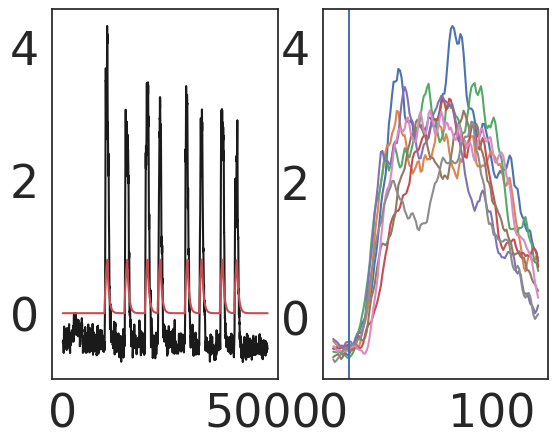

0.9478618346302919


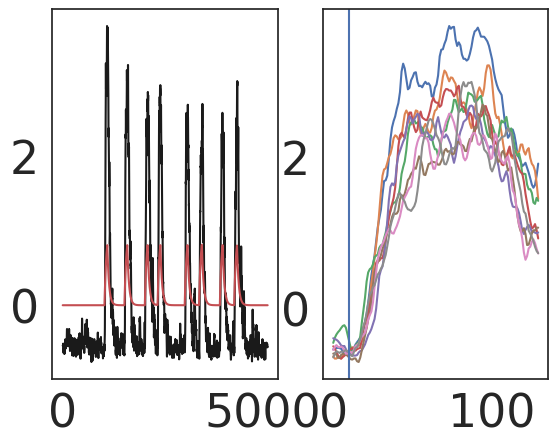

DZ-230605-f3-100_2wk_schooling
DZ-230605-f5-90_2wk_schooling
ml-230427-f4_schooling-3
DZ-230517_wk2_f2-2_schooling
DZ-230518_wk2_f2-170_schooling
DZ-230503_wk4_f1_schooling
DZ-230519_wk4_f1-2_schooling
DZ-230523_wk4_f2_-140_schooling
0.954006789865289


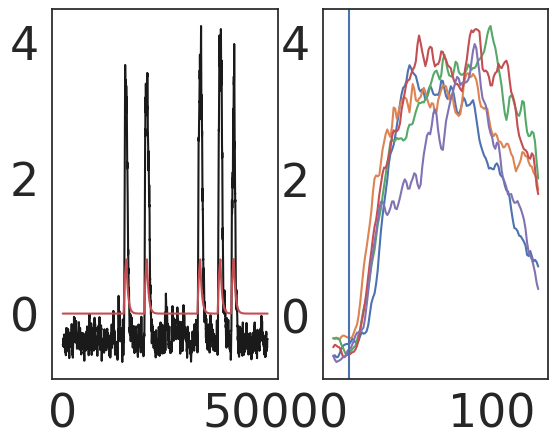

DZ-230427_wk4_f1_schooling
DZ-230522-f2-120_4wk_schooling
DZ-230523_wk4_f1_-110_schooling
DZ-230523_wk4_f4_-90_schooling
DZ-230522_wk6_f3_schooling


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


DZ-230522_wk6_f2_schooling
DZ-230521_wk6_f4_schooling
DZ-230529_wk6_f1_-160_schooling
DZ-230524_wk6_f1-3_schooling
DZ-230503_wk6_f1_schooling


/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


DZ-230525-f1-130_6wk_schooling
DZ-230521_wk6_f2-140_schooling


In [ ]:
#simple response magnitude, selectivity index, and correlation coefficients

wk2_subjects = [
'DZ-230518_wk2_f1_z-130_schooling',
'DZ-230605-f3-100_2wk_schooling',
'DZ-230605-f5-90_2wk_schooling',
'ml-230427-f4_schooling-3',
'DZ-230517_wk2_f2-2_schooling',
'DZ-230518_wk2_f2-170_schooling',]

wk4_subjects=[
'DZ-230503_wk4_f1_schooling',
'DZ-230519_wk4_f1-2_schooling',
'DZ-230523_wk4_f2_-140_schooling',
'DZ-230427_wk4_f1_schooling',
'DZ-230522-f2-120_4wk_schooling',
'DZ-230523_wk4_f1_-110_schooling',
'DZ-230523_wk4_f4_-90_schooling',]

wk6_subjects=[
'DZ-230522_wk6_f3_schooling',
'DZ-230522_wk6_f2_schooling',
'DZ-230521_wk6_f4_schooling',
'DZ-230529_wk6_f1_-160_schooling',
'DZ-230524_wk6_f1-3_schooling',
'DZ-230503_wk6_f1_schooling',
'DZ-230525-f1-130_6wk_schooling',
'DZ-230521_wk6_f2-140_schooling']

subjects = wk2_subjects+wk4_subjects+wk6_subjects


resample_Hz = 10 #define common Hz to resample all
ts_fraction = [0.05,1.0] #fraction of full timeseries to use


for f in subjects:
      print(f)
      path = '/content/drive/MyDrive/Zada_Schulze_paper/Imaging_data/Schooling/'+f+'/'

      #load processed imaging data
      load = np.load(path+'neuron_details_with-anatomy.npz', allow_pickle=True)
      coords = load['neuron_coordinates']
      xs=[i[0] for i in coords]
      ys=[i[1] for i in coords]
      tr=load['neuron_traces']
      neuron_locations = load['neuron_anatomy']

      load=np.load(path+'movement_stats.npz', allow_pickle=True)
      tmp=load['time_sec']
      time=[i-tmp[0] for i in tmp]
      new_time_base = int(max(time)*resample_Hz)
      tail_angle=resized(load['angle'],new_time_base)
      turn_array=resized(load['any_turn_array'],new_time_base)
      stimulus=load['stim']

      s0=np.zeros(len(stimulus));
      s1=np.zeros(len(stimulus));
      s2=np.zeros(len(stimulus));
      s3=np.zeros(len(stimulus));
      s4=np.zeros(len(stimulus));

      for ndx,i in enumerate(stimulus):
          if i==0:
            s0[ndx]=1
          if i==1:
            s1[ndx]=1
          if i==2:
            s2[ndx]=1
          if i==3:
            s3[ndx]=1
          if i==4:
            s4[ndx]=1

      #resample all to common Hz, and crop to first X% of behavior
      S1=resized(s1,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
      S2=resized(s2,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
      S3=resized(s3,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
      S4=resized(s4,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
      MOV=resized(turn_array,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]

      #get stimulus onset times
      post_stim_dur=12*resample_Hz   #post-stimulus duration (s)

      S1_ON = [ndx for ndx,i in enumerate(S1) if i>0 and S1[ndx-1]==0 and resample_Hz < ndx < len(S1)-post_stim_dur]
      S2_ON = [ndx for ndx,i in enumerate(S2) if i>0 and S2[ndx-1]==0 and resample_Hz < ndx < len(S2)-post_stim_dur]
      S3_ON = [ndx for ndx,i in enumerate(S3) if i>0 and S3[ndx-1]==0 and resample_Hz < ndx < len(S3)-post_stim_dur]
      S4_ON = [ndx for ndx,i in enumerate(S4) if i>0 and S4[ndx-1]==0 and resample_Hz < ndx < len(S4)-post_stim_dur]
      MOV_ON = [ndx for ndx,i in enumerate(MOV) if i>0 and MOV[ndx-1]==0 and resample_Hz < ndx < len(MOV)-post_stim_dur]

      #convolve regressors
      decay = 3.0*resample_Hz #(calcium decay - 3s x volume Hz sampling)
      tmp = pd.DataFrame(data=S1)
      s1_conv=np.array(tmp.ewm(halflife = decay).mean()).T[0]
      tmp = pd.DataFrame(data=S2)
      s2_conv=np.array(tmp.ewm(halflife = decay).mean()).T[0]
      tmp = pd.DataFrame(data=S3)
      s3_conv=np.array(tmp.ewm(halflife = decay).mean()).T[0]
      tmp = pd.DataFrame(data=S4)
      s4_conv=np.array(tmp.ewm(halflife = decay).mean()).T[0]
      tmp = pd.DataFrame(data=MOV)
      mov_conv=np.array(tmp.ewm(halflife = decay).mean()).T[0]

      regressors = [s1_conv,s2_conv,s3_conv,s4_conv,mov_conv]
      onsets = [S1_ON,S2_ON,S3_ON,S4_ON,MOV_ON]

      neuron_traces__=[]
      raw_traces=[]
      for i in tr:
          tmp = resized(i,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
          kernel_size = int(1.0*resample_Hz) #1s
          kernel = np.ones(kernel_size) / kernel_size
          tmp2 = np.convolve(tmp, kernel, mode='smooth') #smooth
          tmp2[:resample_Hz*1]=tmp2[resample_Hz*1] #correcting for edge effects
          tmp2[-resample_Hz*1:]=tmp2[-resample_Hz*1] #correcting for edge effects
          neuron_traces__.append(scipy.stats.zscore(tmp2))
          raw_traces.append(tmp2) #append zscore

      output_ops =np.load(path+"suite2p/plane0/ops.npy", allow_pickle=True).item()

      decay = 3.0*resample_Hz #(calcium decay - 3s x volume Hz sampling)
      tmp = pd.DataFrame(data=S1)
      s1_conv=np.array(tmp.ewm(halflife = decay).mean()).T[0]

      corr_coeffs = [] #pearsons r
      responses = [] #mean post-stimulus response
      psths = [] #peri-stimulus timeseries
      selectivity = [] #[object, drift]
      for regressor,onset in zip(regressors, onsets):
        tmp=[]; tmp2=[]; tmp3=[];
        for tr,rtr in zip(neuron_traces__, raw_traces):
          r,p = scipy.stats.pearsonr(tr,regressor)
          tmp.append(r)
          tmp2.append(np.mean([np.max(tr[i:i+post_stim_dur]) for i in onset if i<(len(tr)-post_stim_dur)]))
          tmp3.append([tr[i-resample_Hz:i+post_stim_dur] for i in onset if i<(len(tr)-post_stim_dur)])
          if abs(r) > 0.93:
            print(r)
            plt.subplot(121)
            plt.plot(tr, 'k')
            plt.plot(regressor, 'r')
            plt.subplot(122)
            for i in onset:
              plt.plot(tr[i-resample_Hz:i+post_stim_dur])
            plt.axvline(resample_Hz)
            plt.show()
        corr_coeffs.append(tmp)
        responses.append(tmp2)
        psths.append(tmp3)
      for tr in neuron_traces__:
        obj_selectivity_index = abs(np.mean([np.max(tr[i:i+post_stim_dur]) for i in onsets[0]]) - np.mean([np.max(tr[i:i+post_stim_dur]) for i in onsets[1]]))
        drf_selectivity_index = abs(np.mean([np.max(tr[i:i+post_stim_dur]) for i in onsets[0]]) - np.mean([np.max(tr[i:i+post_stim_dur]) for i in onsets[3]]))
        selectivity.append([obj_selectivity_index,drf_selectivity_index])

      np.savez(path+'PSTHs.npz', responses = responses, selectivity = selectivity)#, psths = psths)


DZ-230518_wk2_f1_z-130_schooling
6 5


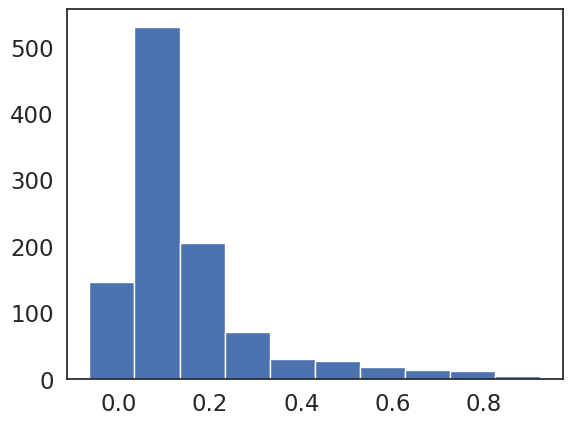

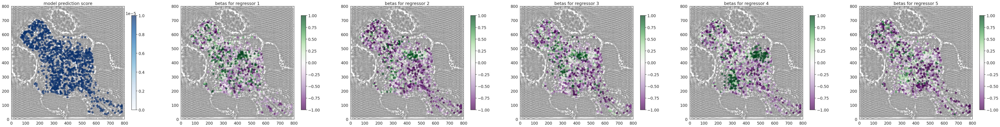

DZ-230605-f3-100_2wk_schooling
6 5


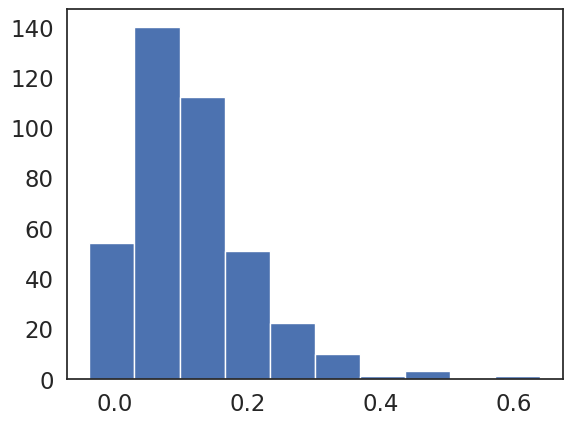

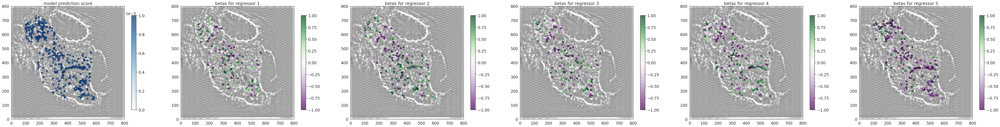

ml-230427-f4_schooling-3
6 5


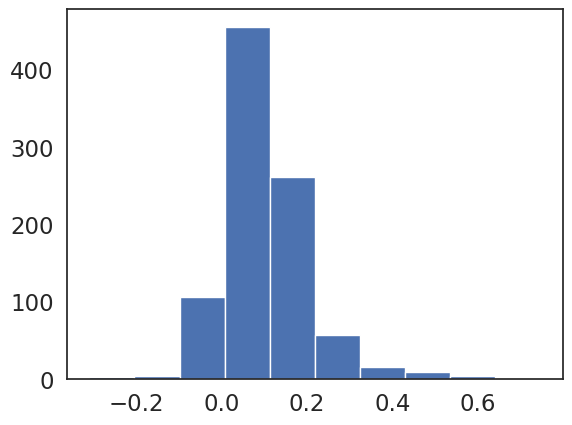

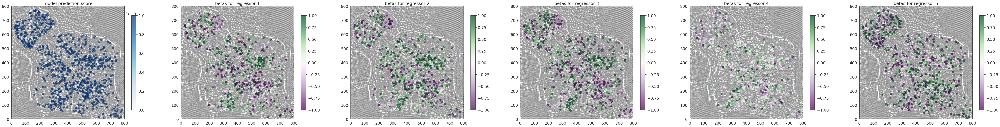

DZ-230517_wk2_f2-2_schooling
6 5


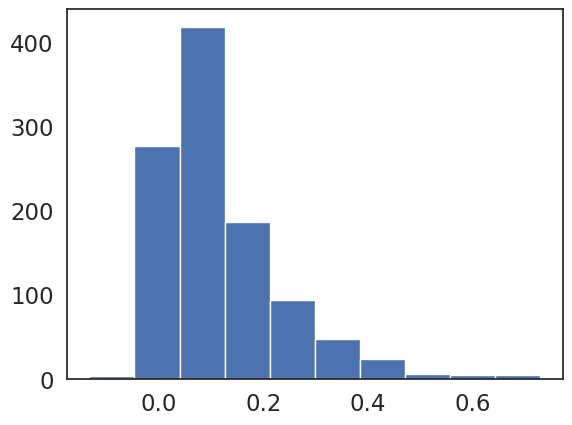

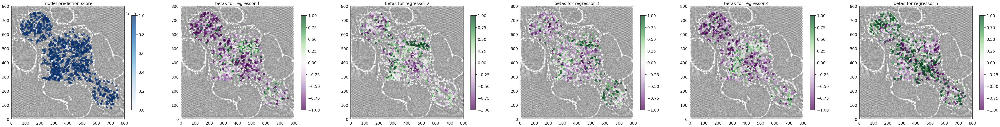

DZ-230503_wk4_f1_schooling
6 5


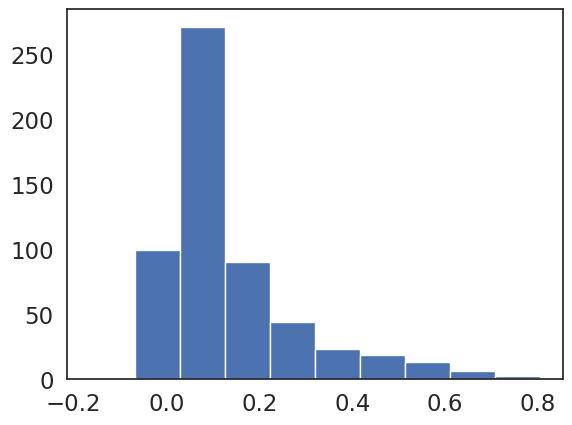

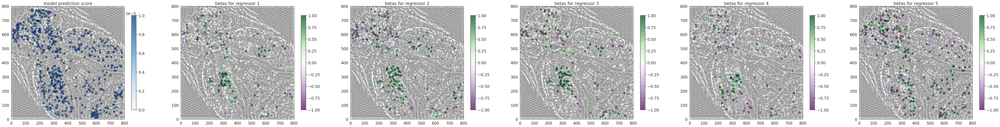

DZ-230519_wk4_f1-2_schooling
6 5


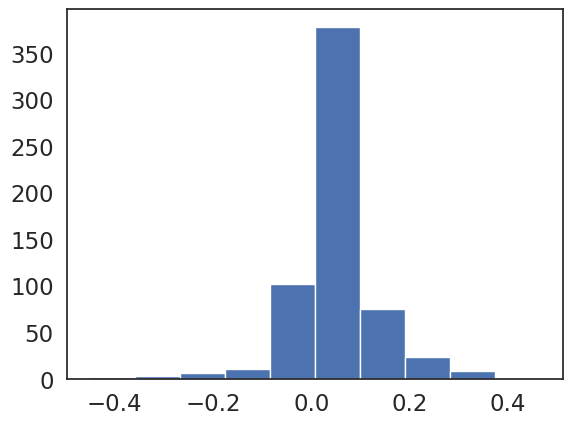

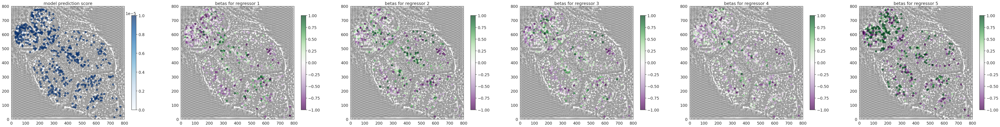

DZ-230523_wk4_f2_-140_schooling
6 5


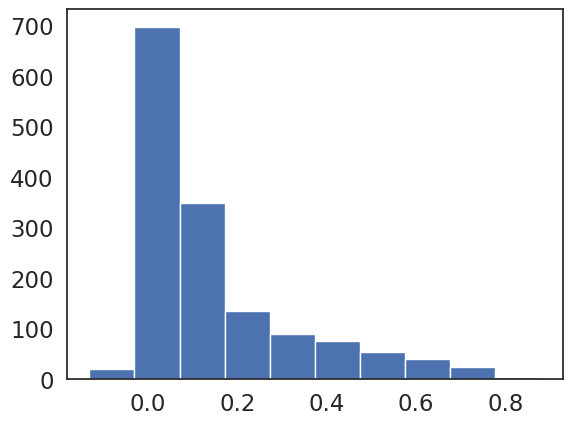

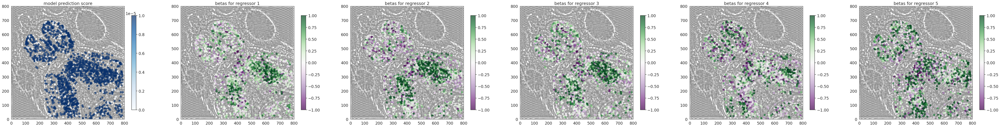

DZ-230427_wk4_f1_schooling
6 5


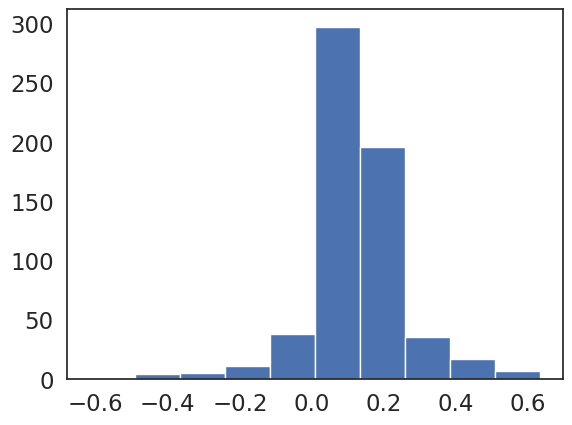

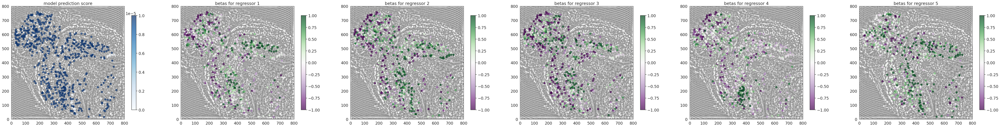

DZ-230522_wk6_f3_schooling
6 5


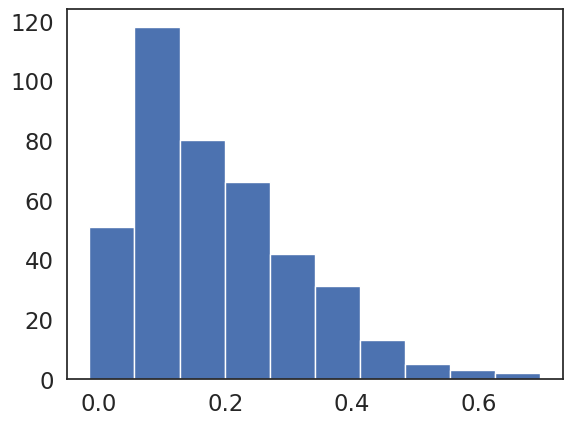

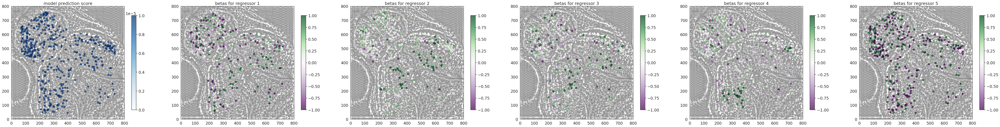

DZ-230522_wk6_f2_schooling
6 5


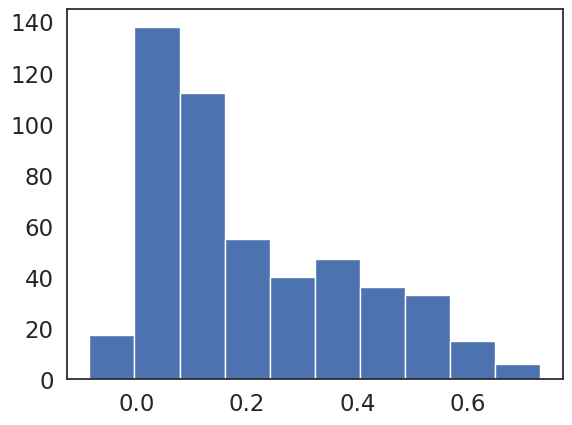

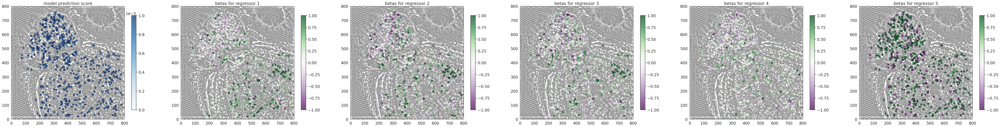

DZ-230521_wk6_f4_schooling
6 5


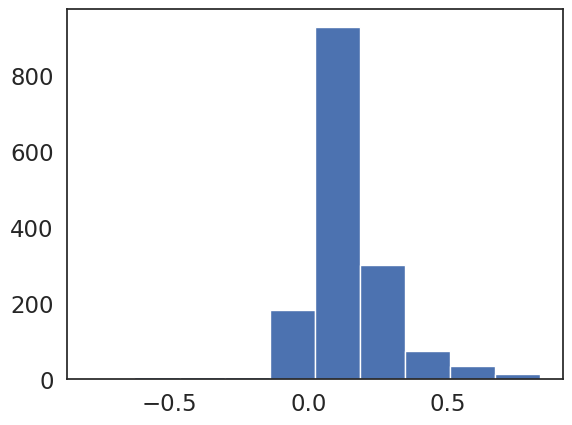

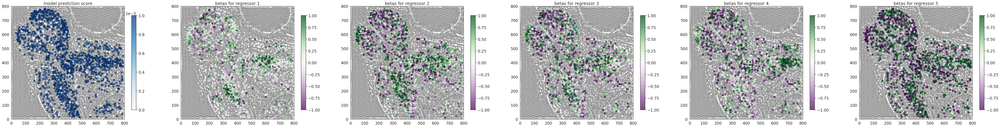

DZ-230529_wk6_f1_-160_schooling
6 5


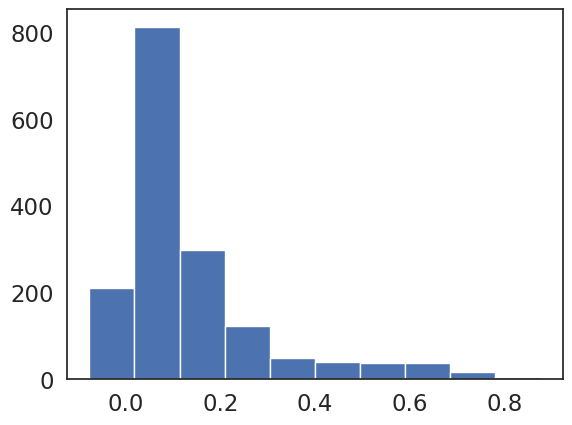

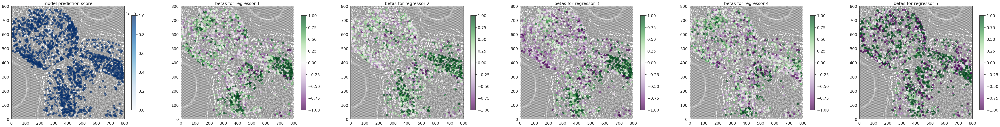

In [ ]:
#Here, load data from linear model for plotting and stats

wk2_subjects = [
'DZ-230518_wk2_f1_z-130_schooling',
'DZ-230605-f3-100_2wk_schooling',
'ml-230427-f4_schooling-3',
'DZ-230517_wk2_f2-2_schooling',
]

wk4_subjects=[
'DZ-230503_wk4_f1_schooling',
'DZ-230519_wk4_f1-2_schooling',
'DZ-230523_wk4_f2_-140_schooling',
'DZ-230427_wk4_f1_schooling',
]

wk6_subjects=[
'DZ-230522_wk6_f3_schooling',
'DZ-230522_wk6_f2_schooling',
'DZ-230521_wk6_f4_schooling',
'DZ-230529_wk6_f1_-160_schooling',
]

subjects = wk2_subjects+wk4_subjects+wk6_subjects


resample_Hz = 10 #define common Hz to resample all
ts_fraction = [0.05,1.0] #fraction of full timeseries to use


for f in subjects:
      print(f)
      path = '/content/drive/MyDrive/Zada_Schulze_paper/Imaging_data/Schooling/'+f+'/'

      #load processed imaging data
      load = np.load(path+'neuron_details_with-anatomy.npz', allow_pickle=True)
      coords = load['neuron_coordinates']
      xs=[i[0] for i in coords]
      ys=[i[1] for i in coords]
      tr=load['neuron_traces']
      neuron_locations = load['neuron_anatomy']

      output_ops =np.load(path+"suite2p/plane0/ops.npy", allow_pickle=True).item()

      load=np.load(path+'linear_model_outputs_ridge.npz', allow_pickle=True)
      basis_functions=load['basis_functions']
      pred_scores=load['pred_scores']
      weight_set=load['weight_set']

      print(len(weight_set), len(weight_set[:-1]))

      plt.hist(pred_scores)
      plt.show()

      plt.figure(figsize=[75,12])
      plt.subplot(1,6,1)
      plt.imshow(output_ops['meanImgE'], cmap='gray', alpha=0.7)
      plt.scatter(xs,ys,c=pred_scores, cmap='Blues', s=60,  alpha=0.7, vmin=0, vmax=0.00001)
      plt.xlim(0,800)
      plt.ylim(0,800)
      plt.title('model prediction score')
      plt.colorbar(shrink=0.6)

      for ndx,weights in enumerate(weight_set):
        betas = [np.mean(i[0]) for i in weights]
        plt.subplot(1,6,ndx+2)
        plt.imshow(output_ops['meanImgE'], cmap='gray', alpha=0.7)
        plt.scatter(xs,ys,c=betas, s=60, alpha=0.7, cmap='PRGn', vmin=-1.0, vmax=1.0)
        plt.xlim(0,800)
        plt.ylim(0,800)
        plt.title('betas for regressor '+str(ndx+1))
        plt.colorbar(shrink=0.6)
      #plt.savefig(figure_savepath +"Linear_model/Beta_maps_fish_"+f+".pdf", transparent=True, bbox_inches='tight', pad_inches=0.2)
      plt.show()


DZ-230518_wk2_f1_z-130_schooling
DZ-230605-f3-100_2wk_schooling
DZ-230605-f5-90_2wk_schooling
ml-230427-f4_schooling-3
DZ-230517_wk2_f2-2_schooling
DZ-230518_wk2_f2-170_schooling
DZ-230503_wk4_f1_schooling
DZ-230519_wk4_f1-2_schooling
DZ-230523_wk4_f2_-140_schooling
DZ-230427_wk4_f1_schooling
DZ-230522-f2-120_4wk_schooling
DZ-230523_wk4_f1_-110_schooling
DZ-230523_wk4_f4_-90_schooling
DZ-230522_wk6_f3_schooling
DZ-230522_wk6_f2_schooling
DZ-230521_wk6_f4_schooling
DZ-230529_wk6_f1_-160_schooling
DZ-230524_wk6_f1-3_schooling
DZ-230503_wk6_f1_schooling
DZ-230525-f1-130_6wk_schooling
DZ-230521_wk6_f2-140_schooling
telencephalon
SHOWING PLOTS FOR REGRESSOR  s1
s1 betas
wk2v4 week: statistics for comparison: linear mixed-effects model, with fish id as random variable
group[T.4]: p-value = 0.593408
wk2v6 week: statistics for comparison: linear mixed-effects model, with fish id as random variable
group[T.6]: p-value = 0.148139
wk4v6 week: statistics for comparison: linear mixed-effects model,

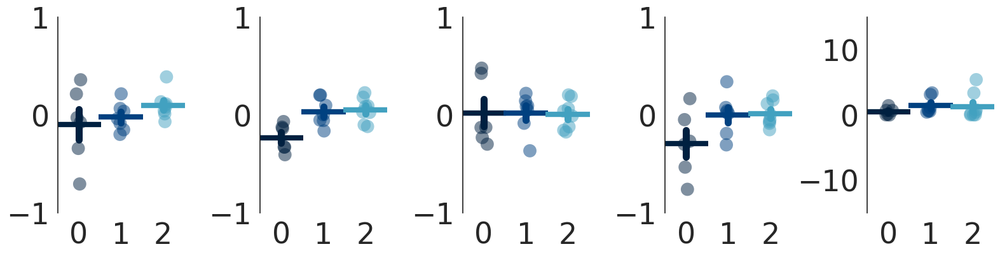

DZ-230518_wk2_f1_z-130_schooling
DZ-230605-f3-100_2wk_schooling
DZ-230605-f5-90_2wk_schooling
ml-230427-f4_schooling-3
DZ-230517_wk2_f2-2_schooling
DZ-230518_wk2_f2-170_schooling
DZ-230503_wk4_f1_schooling
DZ-230519_wk4_f1-2_schooling
DZ-230523_wk4_f2_-140_schooling
DZ-230427_wk4_f1_schooling
DZ-230522-f2-120_4wk_schooling
DZ-230523_wk4_f1_-110_schooling
DZ-230523_wk4_f4_-90_schooling
DZ-230522_wk6_f3_schooling
DZ-230522_wk6_f2_schooling
DZ-230521_wk6_f4_schooling
DZ-230529_wk6_f1_-160_schooling
DZ-230524_wk6_f1-3_schooling
DZ-230503_wk6_f1_schooling
DZ-230525-f1-130_6wk_schooling
DZ-230521_wk6_f2-140_schooling
dienencephalon
SHOWING PLOTS FOR REGRESSOR  s1
s1 betas
wk2v4 week: statistics for comparison: linear mixed-effects model, with fish id as random variable
group[T.4]: p-value = 0.793590
wk2v6 week: statistics for comparison: linear mixed-effects model, with fish id as random variable
group[T.6]: p-value = 0.544263
wk4v6 week: statistics for comparison: linear mixed-effects model

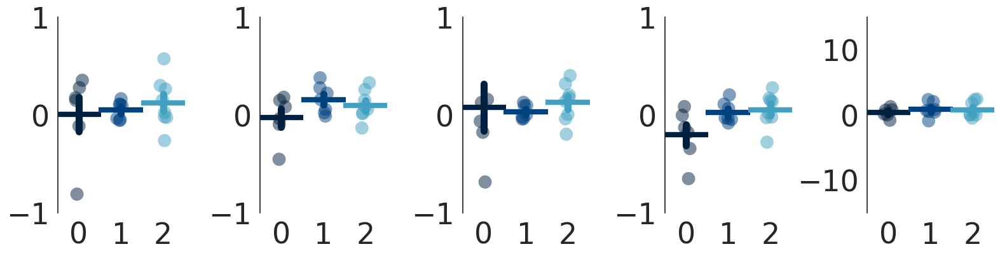

DZ-230518_wk2_f1_z-130_schooling
DZ-230605-f3-100_2wk_schooling
DZ-230605-f5-90_2wk_schooling
ml-230427-f4_schooling-3
DZ-230517_wk2_f2-2_schooling
DZ-230518_wk2_f2-170_schooling
DZ-230503_wk4_f1_schooling
DZ-230519_wk4_f1-2_schooling
DZ-230523_wk4_f2_-140_schooling
DZ-230427_wk4_f1_schooling
DZ-230522-f2-120_4wk_schooling
DZ-230523_wk4_f1_-110_schooling
DZ-230523_wk4_f4_-90_schooling
DZ-230522_wk6_f3_schooling
DZ-230522_wk6_f2_schooling
DZ-230521_wk6_f4_schooling
DZ-230529_wk6_f1_-160_schooling
DZ-230524_wk6_f1-3_schooling
DZ-230503_wk6_f1_schooling
DZ-230525-f1-130_6wk_schooling
DZ-230521_wk6_f2-140_schooling
mesencephalon
SHOWING PLOTS FOR REGRESSOR  s1
s1 betas
wk2v4 week: statistics for comparison: linear mixed-effects model, with fish id as random variable
group[T.4]: p-value = 0.351078
wk2v6 week: statistics for comparison: linear mixed-effects model, with fish id as random variable
group[T.6]: p-value = 0.135678
wk4v6 week: statistics for comparison: linear mixed-effects model,

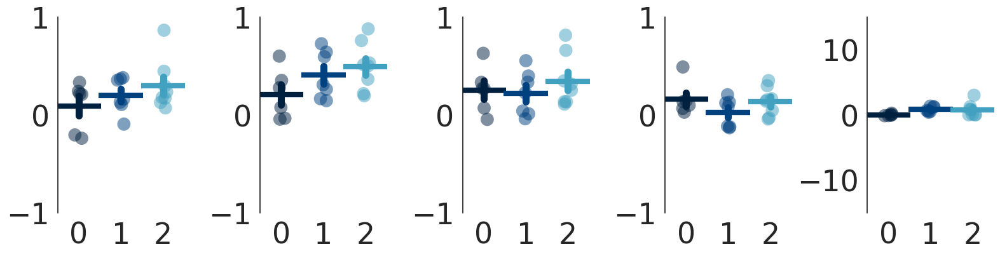

DZ-230518_wk2_f1_z-130_schooling
DZ-230605-f3-100_2wk_schooling
DZ-230605-f5-90_2wk_schooling
ml-230427-f4_schooling-3
DZ-230517_wk2_f2-2_schooling
DZ-230518_wk2_f2-170_schooling
DZ-230503_wk4_f1_schooling
DZ-230519_wk4_f1-2_schooling
DZ-230523_wk4_f2_-140_schooling
DZ-230427_wk4_f1_schooling
DZ-230522-f2-120_4wk_schooling
DZ-230523_wk4_f1_-110_schooling
DZ-230523_wk4_f4_-90_schooling
DZ-230522_wk6_f3_schooling
DZ-230522_wk6_f2_schooling
DZ-230521_wk6_f4_schooling
DZ-230529_wk6_f1_-160_schooling
DZ-230524_wk6_f1-3_schooling
DZ-230503_wk6_f1_schooling
DZ-230525-f1-130_6wk_schooling
DZ-230521_wk6_f2-140_schooling
rhombencephalon
SHOWING PLOTS FOR REGRESSOR  s1
s1 betas
wk2v4 week: statistics for comparison: linear mixed-effects model, with fish id as random variable
group[T.4]: p-value = 1.000000
wk2v6 week: statistics for comparison: linear mixed-effects model, with fish id as random variable
group[T.6]: p-value = 0.114256
wk4v6 week: statistics for comparison: linear mixed-effects mode

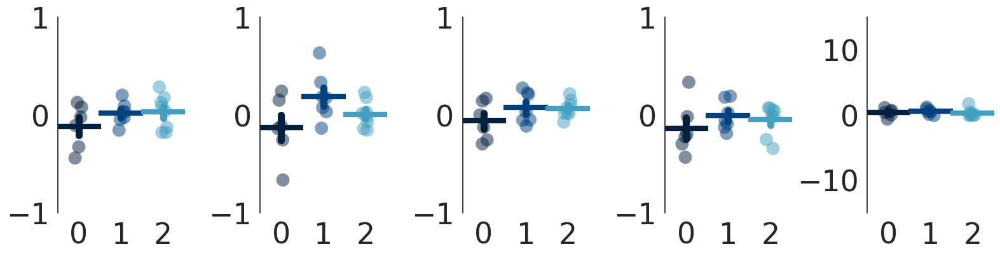

In [ ]:
#plotting data for neurons (pooled across animals)

wk2_subjects = [
'DZ-230518_wk2_f1_z-130_schooling',
'DZ-230605-f3-100_2wk_schooling',
'DZ-230605-f5-90_2wk_schooling',
'ml-230427-f4_schooling-3',
'DZ-230517_wk2_f2-2_schooling',
'DZ-230518_wk2_f2-170_schooling',]

wk4_subjects=[
'DZ-230503_wk4_f1_schooling',
'DZ-230519_wk4_f1-2_schooling',
'DZ-230523_wk4_f2_-140_schooling',
'DZ-230427_wk4_f1_schooling',
'DZ-230522-f2-120_4wk_schooling',
'DZ-230523_wk4_f1_-110_schooling',
'DZ-230523_wk4_f4_-90_schooling',]

wk6_subjects=[
'DZ-230522_wk6_f3_schooling',
'DZ-230522_wk6_f2_schooling',
'DZ-230521_wk6_f4_schooling',
'DZ-230529_wk6_f1_-160_schooling',
'DZ-230524_wk6_f1-3_schooling',
'DZ-230503_wk6_f1_schooling',
'DZ-230525-f1-130_6wk_schooling',
'DZ-230521_wk6_f2-140_schooling']

subjects = wk2_subjects+wk4_subjects+wk6_subjects


brain_regions = ['dorsal_forebrain', 'ventral_forebrain', 'habenula','thalamus',\
                 'left_tectum_neuropil', 'left_tectum_cell-layer',\
                 'right_tectum_neuropil', 'right_tectum_cell-layer',\
                 'cerebellum', 'hindbrain']

brain_region_groupings = [['telencephalon', 'dorsal_forebrain', 'ventral_forebrain'],\
                          ['dienencephalon', 'habenula','thalamus'],\
                          ['mesencephalon', 'left_tectum_neuropil', 'left_tectum_cell-layer','right_tectum_neuropil', 'right_tectum_cell-layer'],\
                          ['rhombencephalon', 'cerebellum', 'hindbrain']]


resample_Hz = 10 #define common Hz to resample all
ts_fraction = [0.05,1.0] #fraction of full timeseries to use

for region in brain_region_groupings:

    b_wk2={}; b_wk4={}; b_wk6={}; #betas
    for i in ['f_id','f_grp','s1','s2','s3','s4','mov','s1_byfish','s2_byfish','s3_byfish','s4_byfish','mov_byfish']: #each stimulus type
      b_wk2[i]=[]; b_wk4[i]=[]; b_wk6[i]=[];

    for f in subjects:

      print(f)
      path = '/content/drive/MyDrive/Zada_Schulze_paper/Imaging_data/Schooling/'+f+'/'

      load = np.load(path+'neuron_details_with-anatomy.npz', allow_pickle=True)
      neuron_locations = load['neuron_anatomy']

      load=np.load(path+'linear_model_outputs_ridge.npz', allow_pickle=True)
      pred_scores=load['pred_scores']
      weight_set=load['weight_set']

      if f in wk2_subjects:
        for index,(weights,regs,regs_byfish) in enumerate(zip(weight_set, ['s1','s2','s3','s4','mov'],['s1_byfish','s2_byfish','s3_byfish','s4_byfish','mov_byfish'])):
          b_wk2[regs_byfish].append(np.mean([np.mean(i[0]) for i,loc in zip(weights,neuron_locations) if loc in region]))
          for i,j,loc in zip(weights,pred_scores,neuron_locations):
            if loc in region:
              b_wk2[regs].append(np.mean(i[0]))
              if index==0:
                b_wk2['f_id'].append(f)
                b_wk2['f_grp'].append('2')
      if f in wk4_subjects:
        for index,(weights,regs,regs_byfish) in enumerate(zip(weight_set, ['s1','s2','s3','s4','mov'],['s1_byfish','s2_byfish','s3_byfish','s4_byfish','mov_byfish'])):
          b_wk4[regs_byfish].append(np.mean([np.mean(i[0]) for i,loc in zip(weights,neuron_locations) if loc in region]))
          for i,j,loc in zip(weights,pred_scores,neuron_locations):
            if loc in region:
              b_wk4[regs].append(np.mean(i[0]))
              if index==0:
                b_wk4['f_id'].append(f)
                b_wk4['f_grp'].append('4')
      if f in wk6_subjects:
        for index,(weights,regs,regs_byfish) in enumerate(zip(weight_set, ['s1','s2','s3','s4','mov'],['s1_byfish','s2_byfish','s3_byfish','s4_byfish','mov_byfish'])):
          b_wk6[regs_byfish].append(np.mean([np.mean(i[0]) for i,loc in zip(weights,neuron_locations) if loc in region]))
          for i,j,loc in zip(weights,pred_scores,neuron_locations):
            if loc in region:
              b_wk6[regs].append(np.mean(i[0]))
              if index==0:
                b_wk6['f_id'].append(f)
                b_wk6['f_grp'].append('6')

    plt.figure(figsize=[19,4])
    plt.tight_layout(pad=10.0)
    plt.ylabel('mean beta')
    print(region[0])
    for ndx,(regs,regs_byfish) in enumerate(zip(['s1','s2','s3','s4','mov'],['s1_byfish','s2_byfish','s3_byfish','s4_byfish','mov_byfish'])):


      print("SHOWING PLOTS FOR REGRESSOR ", regs)

      #betas from model
      plt.subplot(1,5,ndx+1)
      print(regs+" betas")

      summary_data = [b_wk2[regs],b_wk4[regs],b_wk6[regs]]
      summary_data_byfish = [b_wk2[regs_byfish],b_wk4[regs_byfish],b_wk6[regs_byfish]]
      summary_fids = [b_wk2['f_id'],b_wk4['f_id'],b_wk6['f_id']]
      summary_grps = [b_wk2['f_grp'],b_wk4['f_grp'],b_wk6['f_grp']]

      sns.pointplot(data=summary_data_byfish, estimator='mean', errorbar='se', markers='_', markersize=50, linewidth=8, palette='ocean', linestyle='none')
      sns.stripplot(data=summary_data_byfish, s=15, palette='ocean', jitter=True, alpha=0.5)

      if regs=='mov':
        plt.ylim(-15,15)
      else:
        plt.ylim(-1,1)
      sns.despine(top=True, right=True, bottom=True)

      for ndxa,groupA,groupB in zip(['wk2v4','wk2v6','wk4v6'],[b_wk2,b_wk2,b_wk4],[b_wk4,b_wk6,b_wk6]):
        print(ndxa,'week: statistics for comparison: linear mixed-effects model, with fish id as random variable')

        df = pd.DataFrame({
                  'cell_values': np.concatenate([groupA[regs],groupB[regs]]),
                  'group': np.concatenate([groupA['f_grp'],groupB['f_grp']]),
                  'fish_ID': np.concatenate([groupA['f_id'],groupB['f_id']]),
                  })

        # Convert 'group' to categorical if it's not already
        df['group'] = df['group'].astype('category')

        # Fit the linear mixed-effects model
        model = smf.mixedlm("cell_values ~ group", df, groups=df['fish_ID'])
        result = model.fit()

        # Print the summary of the model
        #print(result.summary())
        p_values = result.pvalues
        # Print p-values with increased precision
        for index,(param, p_value) in enumerate(p_values.items()):
          if index==1:
            print(f"{param}: p-value = {p_value:.6f}")

    plt.subplots_adjust(hspace=0.5, wspace=0.6)
    plt.savefig(figure_savepath +"Linear_model/model_betas_"+region[0]+".pdf", transparent=True, bbox_inches='tight', pad_inches=0.2)
    plt.show()



DZ-230518_wk2_f1_z-130_schooling
DZ-230605-f3-100_2wk_schooling
DZ-230605-f5-90_2wk_schooling
ml-230427-f4_schooling-3
DZ-230517_wk2_f2-2_schooling
DZ-230518_wk2_f2-170_schooling
DZ-230503_wk4_f1_schooling
DZ-230519_wk4_f1-2_schooling
DZ-230523_wk4_f2_-140_schooling
DZ-230427_wk4_f1_schooling
DZ-230522-f2-120_4wk_schooling
DZ-230523_wk4_f1_-110_schooling
DZ-230523_wk4_f4_-90_schooling
DZ-230522_wk6_f3_schooling
DZ-230522_wk6_f2_schooling
DZ-230521_wk6_f4_schooling
DZ-230529_wk6_f1_-160_schooling
DZ-230524_wk6_f1-3_schooling
DZ-230503_wk6_f1_schooling
DZ-230525-f1-130_6wk_schooling
DZ-230521_wk6_f2-140_schooling
telencephalon
SHOWING PLOTS FOR comparison  obj
means, sems, and Ns for data is 
0.5480894030018073 0.014810569812464583 1092
0.6095781579288788 0.011517201293043674 1945
0.6019905031520312 0.008356656894033107 3608
wk2v4 week: statistics for comparison: linear mixed-effects model, with fish id as random variable
group[T.4]: p-value = 0.364586
wk2v6 week: statistics for comparis

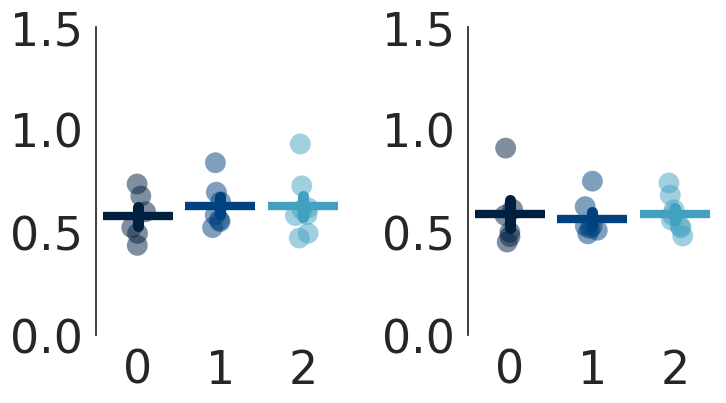

DZ-230518_wk2_f1_z-130_schooling
DZ-230605-f3-100_2wk_schooling
DZ-230605-f5-90_2wk_schooling
ml-230427-f4_schooling-3
DZ-230517_wk2_f2-2_schooling
DZ-230518_wk2_f2-170_schooling
DZ-230503_wk4_f1_schooling
DZ-230519_wk4_f1-2_schooling
DZ-230523_wk4_f2_-140_schooling
DZ-230427_wk4_f1_schooling
DZ-230522-f2-120_4wk_schooling
DZ-230523_wk4_f1_-110_schooling
DZ-230523_wk4_f4_-90_schooling
DZ-230522_wk6_f3_schooling
DZ-230522_wk6_f2_schooling
DZ-230521_wk6_f4_schooling
DZ-230529_wk6_f1_-160_schooling
DZ-230524_wk6_f1-3_schooling
DZ-230503_wk6_f1_schooling
DZ-230525-f1-130_6wk_schooling
DZ-230521_wk6_f2-140_schooling
dienencephalon
SHOWING PLOTS FOR comparison  obj
means, sems, and Ns for data is 
0.6370581682267588 0.036009169715254245 229
0.544073104995799 0.01780417647934238 669
0.5945938207786029 0.01625721616488018 1116
wk2v4 week: statistics for comparison: linear mixed-effects model, with fish id as random variable
group[T.4]: p-value = 0.257769
wk2v6 week: statistics for comparison: 

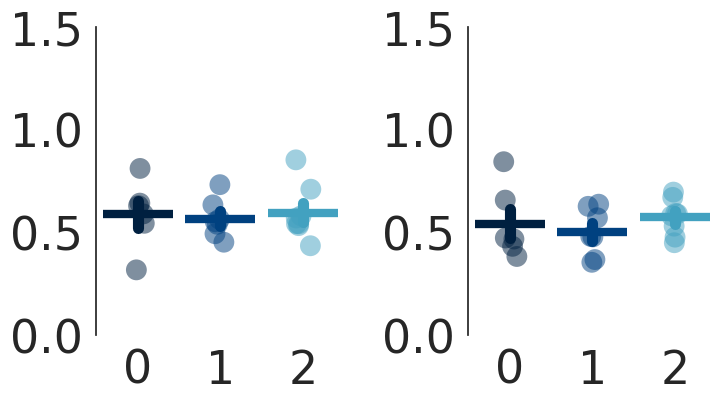

DZ-230518_wk2_f1_z-130_schooling
DZ-230605-f3-100_2wk_schooling
DZ-230605-f5-90_2wk_schooling
ml-230427-f4_schooling-3
DZ-230517_wk2_f2-2_schooling
DZ-230518_wk2_f2-170_schooling
DZ-230503_wk4_f1_schooling
DZ-230519_wk4_f1-2_schooling
DZ-230523_wk4_f2_-140_schooling
DZ-230427_wk4_f1_schooling
DZ-230522-f2-120_4wk_schooling
DZ-230523_wk4_f1_-110_schooling
DZ-230523_wk4_f4_-90_schooling
DZ-230522_wk6_f3_schooling
DZ-230522_wk6_f2_schooling
DZ-230521_wk6_f4_schooling
DZ-230529_wk6_f1_-160_schooling
DZ-230524_wk6_f1-3_schooling
DZ-230503_wk6_f1_schooling
DZ-230525-f1-130_6wk_schooling
DZ-230521_wk6_f2-140_schooling
mesencephalon
SHOWING PLOTS FOR comparison  obj
means, sems, and Ns for data is 
0.6895446411904231 0.016678862962858854 1899
0.808569929720034 0.01294519528846297 4353
0.8850131616872439 0.014265093717332592 3787
wk2v4 week: statistics for comparison: linear mixed-effects model, with fish id as random variable
group[T.4]: p-value = 0.006285
wk2v6 week: statistics for comparison

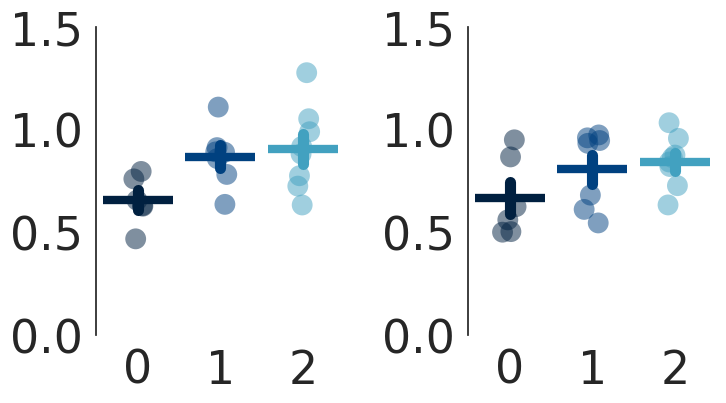

DZ-230518_wk2_f1_z-130_schooling
DZ-230605-f3-100_2wk_schooling
DZ-230605-f5-90_2wk_schooling
ml-230427-f4_schooling-3
DZ-230517_wk2_f2-2_schooling
DZ-230518_wk2_f2-170_schooling
DZ-230503_wk4_f1_schooling
DZ-230519_wk4_f1-2_schooling
DZ-230523_wk4_f2_-140_schooling
DZ-230427_wk4_f1_schooling
DZ-230522-f2-120_4wk_schooling
DZ-230523_wk4_f1_-110_schooling
DZ-230523_wk4_f4_-90_schooling
DZ-230522_wk6_f3_schooling
DZ-230522_wk6_f2_schooling
DZ-230521_wk6_f4_schooling
DZ-230529_wk6_f1_-160_schooling
DZ-230524_wk6_f1-3_schooling
DZ-230503_wk6_f1_schooling
DZ-230525-f1-130_6wk_schooling
DZ-230521_wk6_f2-140_schooling
rhombencephalon
SHOWING PLOTS FOR comparison  obj
means, sems, and Ns for data is 
0.5709140693613193 0.015076138226834365 1177
0.519615925921396 0.012167354410911681 1128
0.49474095963072684 0.01596786245143909 644
wk2v4 week: statistics for comparison: linear mixed-effects model, with fish id as random variable
group[T.4]: p-value = 1.000000
wk2v6 week: statistics for comparis

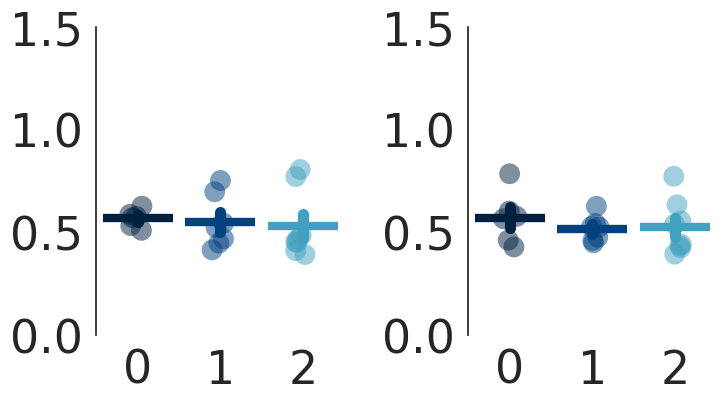

In [ ]:
# Here, plot object selectivity bar graphs across brain regions ()
#plotting data for neurons (pooled across animals, with mixed-effects models to control for animal-to-animal variance)


wk2_subjects = [
'DZ-230518_wk2_f1_z-130_schooling',
'DZ-230605-f3-100_2wk_schooling',
'DZ-230605-f5-90_2wk_schooling',
'ml-230427-f4_schooling-3',
'DZ-230517_wk2_f2-2_schooling',
'DZ-230518_wk2_f2-170_schooling',]

wk4_subjects=[
'DZ-230503_wk4_f1_schooling',
'DZ-230519_wk4_f1-2_schooling',
'DZ-230523_wk4_f2_-140_schooling',
'DZ-230427_wk4_f1_schooling',
'DZ-230522-f2-120_4wk_schooling',
'DZ-230523_wk4_f1_-110_schooling',
'DZ-230523_wk4_f4_-90_schooling',]

wk6_subjects=[
'DZ-230522_wk6_f3_schooling',
'DZ-230522_wk6_f2_schooling',
'DZ-230521_wk6_f4_schooling',
'DZ-230529_wk6_f1_-160_schooling',
'DZ-230524_wk6_f1-3_schooling',
'DZ-230503_wk6_f1_schooling',
'DZ-230525-f1-130_6wk_schooling',
'DZ-230521_wk6_f2-140_schooling']

subjects = wk2_subjects+wk4_subjects+wk6_subjects


brain_regions = ['dorsal_forebrain', 'ventral_forebrain', 'habenula','thalamus',\
                 'left_tectum_neuropil', 'left_tectum_cell-layer',\
                 'right_tectum_neuropil', 'right_tectum_cell-layer',\
                 'cerebellum', 'hindbrain']

brain_region_groupings = [['telencephalon', 'dorsal_forebrain', 'ventral_forebrain'],\
                          ['dienencephalon', 'habenula','thalamus'],\
                          ['mesencephalon', 'left_tectum_neuropil', 'left_tectum_cell-layer','right_tectum_neuropil', 'right_tectum_cell-layer'],\
                          ['rhombencephalon', 'cerebellum', 'hindbrain']]


resample_Hz = 10 #define common Hz to resample all
ts_fraction = [0.05,1.0] #fraction of full timeseries to use

for region in brain_region_groupings:

    b_wk2={}; b_wk4={}; b_wk6={};
    for i in ['obj','drf','obj_byfish','drf_byfish','f_id','f_grp']:
      b_wk2[i]=[]; b_wk4[i]=[]; b_wk6[i]=[];

    for fndx,f in enumerate(subjects):

      print(f)
      path = '/content/drive/MyDrive/Zada_Schulze_paper/Imaging_data/Schooling/'+f+'/'

      load = np.load(path+'neuron_details_with-anatomy.npz', allow_pickle=True)
      neuron_locations = load['neuron_anatomy']

      load=np.load(path+'linear_model_outputs_ridge.npz', allow_pickle=True)
      pred_scores=load['pred_scores']

      load=np.load(path+'PSTHs.npz', allow_pickle=True)
      responses = load['responses']

      weight_set = responses

      if f in wk2_subjects:
        selectivity_index1 = [abs(a-b) for a,b in zip(weight_set[0], weight_set[1])]
        selectivity_index2 = [abs(a-b) for a,b in zip(weight_set[0], weight_set[3])]
        b_wk2['obj_byfish'].append(np.mean([i for i,loc in zip(selectivity_index1,neuron_locations) if loc in region]))
        b_wk2['drf_byfish'].append(np.mean([i for i,loc in zip(selectivity_index2,neuron_locations) if loc in region]))
        for sel1,sel2,loc in zip(selectivity_index1,selectivity_index2, neuron_locations):
          if loc in region:
            b_wk2['obj'].append(sel1)
            b_wk2['drf'].append(sel2)
            b_wk2['f_id'].append(f)#ndx)
            b_wk2['f_grp'].append('2')
      if f in wk4_subjects:
        selectivity_index1 = [abs(a-b) for a,b in zip(weight_set[0], weight_set[1])]
        selectivity_index2 = [abs(a-b) for a,b in zip(weight_set[0], weight_set[3])]
        b_wk4['obj_byfish'].append(np.mean([i for i,loc in zip(selectivity_index1,neuron_locations) if loc in region]))
        b_wk4['drf_byfish'].append(np.mean([i for i,loc in zip(selectivity_index2,neuron_locations) if loc in region]))
        for sel1,sel2,loc in zip(selectivity_index1,selectivity_index2, neuron_locations):
          if loc in region:
            b_wk4['obj'].append(sel1)
            b_wk4['drf'].append(sel2)
            b_wk4['f_id'].append(f)#ndx)
            b_wk4['f_grp'].append('4')
      if f in wk6_subjects:
        selectivity_index1 = [abs(a-b) for a,b in zip(weight_set[0], weight_set[1])]
        selectivity_index2 = [abs(a-b) for a,b in zip(weight_set[0], weight_set[3])]
        b_wk6['obj_byfish'].append(np.mean([i for i,loc in zip(selectivity_index1,neuron_locations) if loc in region]))
        b_wk6['drf_byfish'].append(np.mean([i for i,loc in zip(selectivity_index2,neuron_locations) if loc in region]))
        for sel1,sel2,loc in zip(selectivity_index1,selectivity_index2, neuron_locations):
          if loc in region:
            b_wk6['obj'].append(sel1)
            b_wk6['drf'].append(sel2)
            b_wk6['f_id'].append(f)#ndx)
            b_wk6['f_grp'].append('6')


    plt.figure(figsize=[8,4])
    plt.tight_layout(pad=10.0)
    plt.ylabel('selectivity_index')
    print(region[0])

    for ndx,(regs,regs_byfish) in enumerate(zip(['obj','drf'],['obj_byfish','drf_byfish'])):

      print("SHOWING PLOTS FOR comparison ", regs)

      #selectivity index
      plt.subplot(1,2,ndx+1)
      #plt.title(regs+" selectivity")
      summary_data = [b_wk2[regs],b_wk4[regs],b_wk6[regs]]
      summary_data_byfish = [b_wk2[regs_byfish],b_wk4[regs_byfish],b_wk6[regs_byfish]]
      summary_fids = [b_wk2['f_id'],b_wk4['f_id'],b_wk6['f_id']]
      summary_grps = [b_wk2['f_grp'],b_wk4['f_grp'],b_wk6['f_grp']]

      sns.pointplot(data=summary_data_byfish, estimator='mean', errorbar='se', markers='_', markersize=50, linewidth=8, palette='ocean', linestyle='none')
      sns.stripplot(data=summary_data_byfish, s=15, palette='ocean', jitter=True, alpha=0.5)

      sns.despine(top=True, right=True, bottom=True)
      plt.ylim(0,1.5)



      print("means, sems, and Ns for data is ")
      for data in summary_data:
        print(np.mean(data), scipy.stats.sem(data), len(data))

      for ndxa,groupA,groupB in zip(['wk2v4','wk2v6','wk4v6'],[b_wk2,b_wk2,b_wk4],[b_wk4,b_wk6,b_wk6]):
        print(ndxa,'week: statistics for comparison: linear mixed-effects model, with fish id as random variable')

        df = pd.DataFrame({
                  'cell_values': np.concatenate([groupA[regs],groupB[regs]]),
                  'group': np.concatenate([groupA['f_grp'],groupB['f_grp']]),
                  'fish_ID': np.concatenate([groupA['f_id'],groupB['f_id']]),
                  })

        # Convert 'group' to categorical if it's not already
        df['group'] = df['group'].astype('category')

        # Fit the linear mixed-effects model
        model = smf.mixedlm("cell_values ~ group", df, groups=df['fish_ID'])
        result = model.fit()

        # Print the summary of the model
        #print(result.summary())
        p_values = result.pvalues
        # Print p-values with increased precision
        for index,(param, p_value) in enumerate(p_values.items()):
          if index==1:
            print(f"{param}: p-value = {p_value:.6f}")

    plt.subplots_adjust(hspace=0.5, wspace=0.5)
    plt.savefig(figure_savepath +"Linear_model/selectivity_"+region[0]+".pdf", transparent=True, bbox_inches='tight', pad_inches=0.2)
    plt.show()



0 s1
1 s4
2 s1
3 s4
4 s1
5 s4


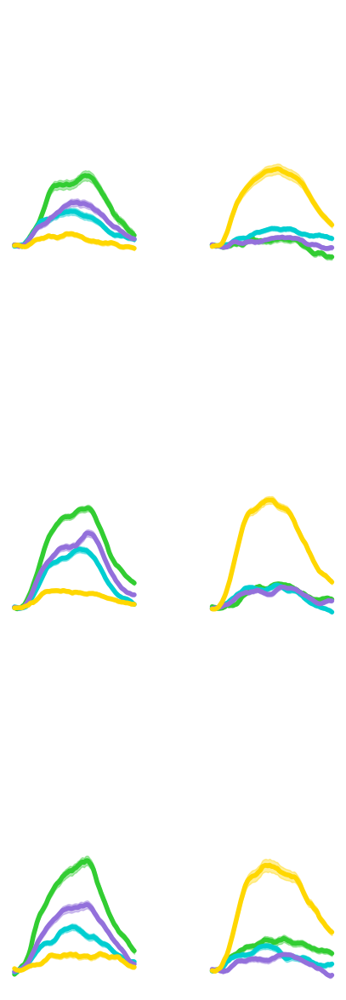

In [ ]:
plt.figure(figsize=[5,15])
plt.tight_layout(pad=5.0)
count=0
#plt.title("positive-going cells, "+ region[0])

for trace,age in zip([twk2,twk4,twk6],[wk2,wk4,wk6]):
      for index1 in ['s1','s4']:
          print(count, index1)
          count+=1
          plt.subplot(3,2,count)
          #plt.axvline(resample_Hz, color='0.3', linewidth=2.0, alpha=0.5)

          score = age[index1]

          for index2, c in zip(['s1','s2','s3','s4'], ['limegreen', 'darkturquoise', 'mediumpurple', 'gold']):
            traces = trace[index2]
            tmp=[t for t,i in zip(traces,score) if i==1]
            if len(tmp)>1:
              plt.plot(np.nanmean(tmp, axis = 0), color = c, linewidth=4)
              plt.fill_between(np.arange(np.nanmean(tmp, axis=0).shape[0]),
                    np.nanmean(tmp, axis=0)+scipy.stats.sem(tmp, axis=0),
                    np.nanmean(tmp, axis=0)-scipy.stats.sem(tmp, axis=0), color=c, alpha=0.4)
          plt.ylim(-0.2,2.2)
          plt.xticks([])
          plt.yticks([])
plt.subplots_adjust(hspace=0.4, wspace=0.5)
sns.despine(bottom=True, left=True)
plt.savefig(figure_savepath +"Linear_model/responsive-cells_examples_all__summary.pdf", transparent=True, bbox_inches='tight', pad_inches=0.2)
plt.show()

In [ ]:
#PSTHs, with motor or non-motor

thresh = 10 #percentile of beta weight distribution

wk2_subjects = [
'DZ-230518_wk2_f1_z-130_schooling',
'DZ-230605-f3-100_2wk_schooling',
'DZ-230605-f5-90_2wk_schooling',
'ml-230427-f4_schooling-3',
'DZ-230517_wk2_f2-2_schooling',
'DZ-230518_wk2_f2-170_schooling',]

wk4_subjects=[
'DZ-230503_wk4_f1_schooling',
'DZ-230519_wk4_f1-2_schooling',
'DZ-230523_wk4_f2_-140_schooling',
'DZ-230427_wk4_f1_schooling',
'DZ-230522-f2-120_4wk_schooling',
'DZ-230523_wk4_f1_-110_schooling',
'DZ-230523_wk4_f4_-90_schooling',]

wk6_subjects=[
'DZ-230522_wk6_f3_schooling',
'DZ-230522_wk6_f2_schooling',
'DZ-230521_wk6_f4_schooling',
'DZ-230529_wk6_f1_-160_schooling',
'DZ-230524_wk6_f1-3_schooling',
'DZ-230503_wk6_f1_schooling',
'DZ-230525-f1-130_6wk_schooling',
'DZ-230521_wk6_f2-140_schooling']

subjects = wk2_subjects+wk4_subjects+wk6_subjects


brain_regions = ['dorsal_forebrain', 'ventral_forebrain', 'habenula','thalamus',\
                 'left_tectum_neuropil', 'left_tectum_cell-layer',\
                 'right_tectum_neuropil', 'right_tectum_cell-layer',\
                 'cerebellum', 'hindbrain']

brain_region_groupings = [['telencephalon', 'dorsal_forebrain', 'ventral_forebrain'],\
                          ['dienencephalon', 'habenula','thalamus'],\
                          ['mesencephalon', 'left_tectum_neuropil', 'left_tectum_cell-layer','right_tectum_neuropil', 'right_tectum_cell-layer'],\
                          ['rhombencephalon', 'cerebellum', 'hindbrain']]


resample_Hz = 10 #define common Hz to resample all
ts_fraction = [0.05,1.0] #fraction of full timeseries to use

wk2={}; wk4={}; wk6={}; #summary stats for each age group
twk2={}; twk4={}; twk6={}; #traces for plotting
for i in ['s1','s2','s3','s4']: #each stimulus type
      wk2[i]=[]; wk4[i]=[]; wk6[i]=[];
      twk2[i]=[]; twk4[i]=[]; twk6[i]=[];

for f in subjects:
        path = '/content/drive/MyDrive/Zada_Schulze_paper/Imaging_data/Schooling/'+f+'/'

        #load processed imaging data
        load = np.load(path+'neuron_details_with-anatomy.npz', allow_pickle=True)
        coords = load['neuron_coordinates']
        xs=[i[0] for i in coords]
        ys=[i[1] for i in coords]
        tr=load['neuron_traces']
        neuron_locations = load['neuron_anatomy']

        output_ops =np.load(path+"suite2p/plane0/ops.npy", allow_pickle=True).item()

        load=np.load(path+'movement_stats.npz', allow_pickle=True)
        tmp=load['time_sec']
        time=[i-tmp[0] for i in tmp]
        new_time_base = int(max(time)*resample_Hz)
        tail_angle=resized(load['angle'],new_time_base)
        turn_array=resized(load['any_turn_array'],new_time_base)
        stimulus=load['stim']

        load=np.load(path+'linear_model_outputs_ridge.npz', allow_pickle=True)
        pred_scores=load['pred_scores']
        weight_set=load['weight_set']

        s0=np.zeros(len(stimulus));
        s1=np.zeros(len(stimulus));
        s2=np.zeros(len(stimulus));
        s3=np.zeros(len(stimulus));
        s4=np.zeros(len(stimulus));

        for ndx,i in enumerate(stimulus):
          if i==0:
            s0[ndx]=1
          if i==1:
            s1[ndx]=1
          if i==2:
            s2[ndx]=1
          if i==3:
            s3[ndx]=1
          if i==4:
            s4[ndx]=1

        #resample all to common Hz, and crop to first X% of behavior
        S1=resized(s1,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
        S2=resized(s2,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
        S3=resized(s3,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
        S4=resized(s4,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
        MOV=resized(turn_array,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
        tail_angle2 = tail_angle[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]

        #get stimulus onset times
        post_stim_dur=12*resample_Hz   #post-stimulus duration (s)

        S1_ON = [ndx for ndx,i in enumerate(S1) if i>0 and S1[ndx-1]==0 and resample_Hz < ndx < len(S1)-post_stim_dur]
        S2_ON = [ndx for ndx,i in enumerate(S2) if i>0 and S2[ndx-1]==0 and resample_Hz < ndx < len(S2)-post_stim_dur]
        S3_ON = [ndx for ndx,i in enumerate(S3) if i>0 and S3[ndx-1]==0 and resample_Hz < ndx < len(S3)-post_stim_dur]
        S4_ON = [ndx for ndx,i in enumerate(S4) if i>0 and S4[ndx-1]==0 and resample_Hz < ndx < len(S4)-post_stim_dur]
        MOV_ON = [ndx for ndx,i in enumerate(MOV) if i>0 and MOV[ndx-1]==0 and resample_Hz < ndx < len(MOV)-post_stim_dur]

        #if non-move
        S1_ON = [ndx for ndx in S1_ON if sum(turn_array[ndx:ndx+post_stim_dur])==0]
        S2_ON = [ndx for ndx in S2_ON if sum(turn_array[ndx:ndx+post_stim_dur])==0]
        S3_ON = [ndx for ndx in S3_ON if sum(turn_array[ndx:ndx+post_stim_dur])==0]
        S4_ON = [ndx for ndx in S4_ON if sum(turn_array[ndx:ndx+post_stim_dur])==0]

        #if move
        #S1_ON = [ndx for ndx in S1_ON if sum(turn_array[ndx:ndx+post_stim_dur])>0]
        #S2_ON = [ndx for ndx in S2_ON if sum(turn_array[ndx:ndx+post_stim_dur])>0]
        #S3_ON = [ndx for ndx in S3_ON if sum(turn_array[ndx:ndx+post_stim_dur])>0]
        #S4_ON = [ndx for ndx in S4_ON if sum(turn_array[ndx:ndx+post_stim_dur])>0]

        if len(S1_ON)>0 and len(S2_ON)>0 and len(S3_ON)>0 and len(S4_ON)>0:

          print(len(S1_ON),len(S2_ON),len(S3_ON),len(S4_ON))

          #handle fluorescence traces here
          neuron_traces__=[]
          for i in tr:
            tmp = resized(i,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
            kernel_size = int(1.0*resample_Hz) #1s
            kernel = np.ones(kernel_size) / kernel_size
            tmp3 = np.convolve(tmp, kernel, mode='valid') #smooth
            neuron_traces__.append(scipy.stats.zscore(tmp3)) #append zscore

          if f in wk2_subjects:
            for ndx,(summary,onsets) in enumerate(zip(['s1','s2','s3','s4'], [S1_ON,S2_ON,S3_ON,S4_ON])):
              for w,tr in zip(weight_set[ndx],neuron_traces__):
                twk2[summary].append(np.mean([tr[i-resample_Hz:i+post_stim_dur]-np.mean(tr[i-resample_Hz:i]) for i in onsets], axis=0))
                if w[0]>np.percentile([w[0] for w in weight_set[ndx]], 100-thresh):
                    wk2[summary].append(1)
                elif w[0]<np.percentile([w[0] for w in weight_set[ndx]], thresh):
                    wk2[summary].append(-1)
                else:
                    wk2[summary].append(0)

          if f in wk4_subjects:
            for ndx,(summary,onsets) in enumerate(zip(['s1','s2','s3','s4'], [S1_ON,S2_ON,S3_ON,S4_ON])):
              for w,tr in zip(weight_set[ndx],neuron_traces__):
                twk4[summary].append(np.mean([tr[i-resample_Hz:i+post_stim_dur]-np.mean(tr[i-resample_Hz:i]) for i in onsets], axis=0))
                if w[0]>np.percentile([w[0] for w in weight_set[ndx]], 100-thresh):
                    wk4[summary].append(1)
                elif w[0]<np.percentile([w[0] for w in weight_set[ndx]], thresh):
                    wk4[summary].append(-1)
                else:
                    wk4[summary].append(0)

          if f in wk6_subjects:
            for ndx,(summary,onsets) in enumerate(zip(['s1','s2','s3','s4'], [S1_ON,S2_ON,S3_ON,S4_ON])):
              for w,tr in zip(weight_set[ndx],neuron_traces__):
                twk6[summary].append(np.mean([tr[i-resample_Hz:i+post_stim_dur]-np.mean(tr[i-resample_Hz:i]) for i in onsets], axis=0))

                if w[0]>np.percentile([w[0] for w in weight_set[ndx]], 100-thresh):
                    wk6[summary].append(1)
                elif w[0]<np.percentile([w[0] for w in weight_set[ndx]], thresh):
                    wk6[summary].append(-1)
                else:
                    wk6[summary].append(0)

plt.figure(figsize=[5,15])
plt.tight_layout(pad=5.0)
count=0
#plt.title("positive-going cells, "+ region[0])

for trace,age in zip([twk2,twk4,twk6],[wk2,wk4,wk6]):
      for index1 in ['s1','s4']:
          print(count, index1)
          count+=1
          plt.subplot(3,2,count)
          #plt.axvline(resample_Hz, color='0.3', linewidth=2.0, alpha=0.5)

          score = age[index1]

          for index2, c in zip(['s1','s2','s3','s4'], ['limegreen', 'darkturquoise', 'mediumpurple', 'gold']):
            traces = trace[index2]
            tmp=[t for t,i in zip(traces,score) if i==1]
            if len(tmp)>1:
              plt.plot(np.nanmean(tmp, axis = 0), color = c, linewidth=4)
              plt.fill_between(np.arange(np.nanmean(tmp, axis=0).shape[0]),
                    np.nanmean(tmp, axis=0)+scipy.stats.sem(tmp, axis=0),
                    np.nanmean(tmp, axis=0)-scipy.stats.sem(tmp, axis=0), color=c, alpha=0.4)
          plt.ylim(-0.2,2.2)
          plt.xticks([])
          plt.yticks([])
plt.subplots_adjust(hspace=0.4, wspace=0.5)
sns.despine(bottom=True, left=True)
plt.savefig(figure_savepath +"Linear_model/responsive-cells_examples_all__summary_without-mov.pdf", transparent=True, bbox_inches='tight', pad_inches=0.2)
plt.show()



3 5 6 3
6 7 4 8
1 5 5 4
3 6 3 4
5 7 4 4
4 5 8 4
4 4 1 1
5 5 8 4
2 4 2 1
4 10 5 5
5 8 5 7
5 6 7 6
6 8 7 4
3 5 2 5
3 5 2 3


ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 1 dimensions. The detected shape was (3,) + inhomogeneous part.

0 s1
1 s4
2 s1
3 s4
4 s1
5 s4


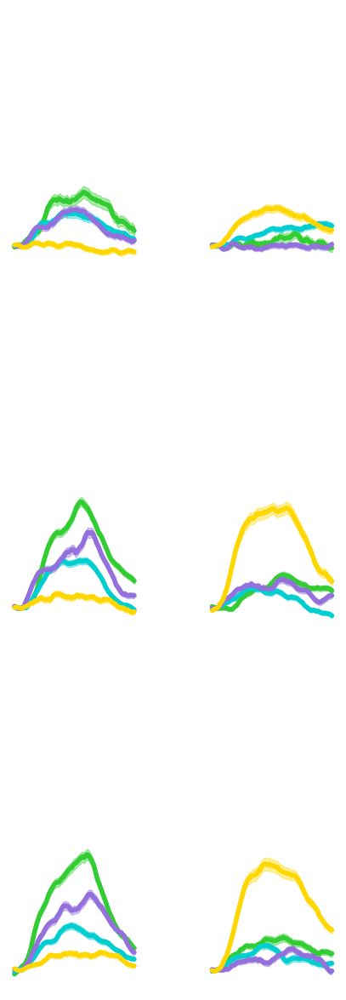

In [ ]:
plt.figure(figsize=[5,15])
plt.tight_layout(pad=5.0)
count=0
#plt.title("positive-going cells, "+ region[0])

for trace,age in zip([twk2,twk4,twk6],[wk2,wk4,wk6]):
      for index1 in ['s1','s4']:
          print(count, index1)
          count+=1
          plt.subplot(3,2,count)
          #plt.axvline(resample_Hz, color='0.3', linewidth=2.0, alpha=0.5)

          score = age[index1]

          for index2, c in zip(['s1','s2','s3','s4'], ['limegreen', 'darkturquoise', 'mediumpurple', 'gold']):
            traces = trace[index2]
            tmp=[t for t,i in zip(traces,score) if i==1]
            if len(tmp)>1:
              plt.plot(np.nanmean(tmp, axis = 0), color = c, linewidth=4)
              plt.fill_between(np.arange(np.nanmean(tmp, axis=0).shape[0]),
                    np.nanmean(tmp, axis=0)+scipy.stats.sem(tmp, axis=0),
                    np.nanmean(tmp, axis=0)-scipy.stats.sem(tmp, axis=0), color=c, alpha=0.4)
          plt.ylim(-0.2,2.2)
          plt.xticks([])
          plt.yticks([])
plt.subplots_adjust(hspace=0.4, wspace=0.5)
sns.despine(bottom=True, left=True)
plt.savefig(figure_savepath +"Linear_model/responsive-cells_examples_all__summary_without-mov.pdf", transparent=True, bbox_inches='tight', pad_inches=0.2)
plt.show()


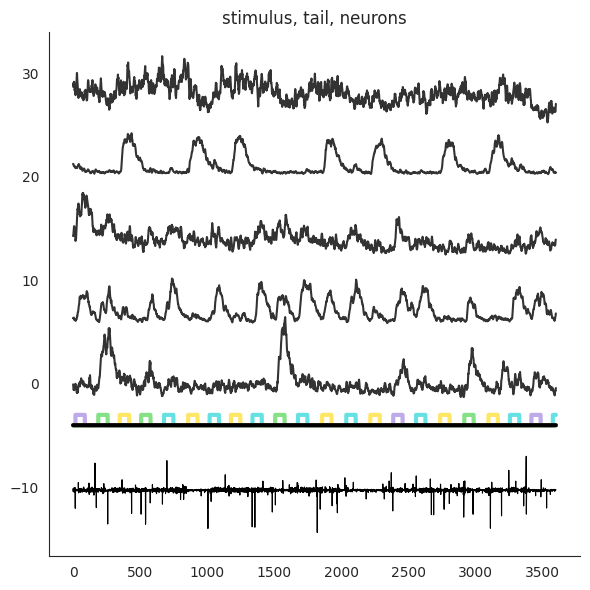

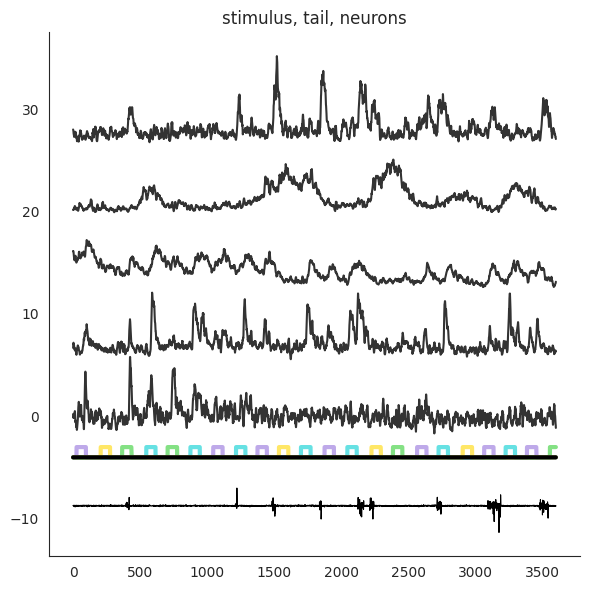

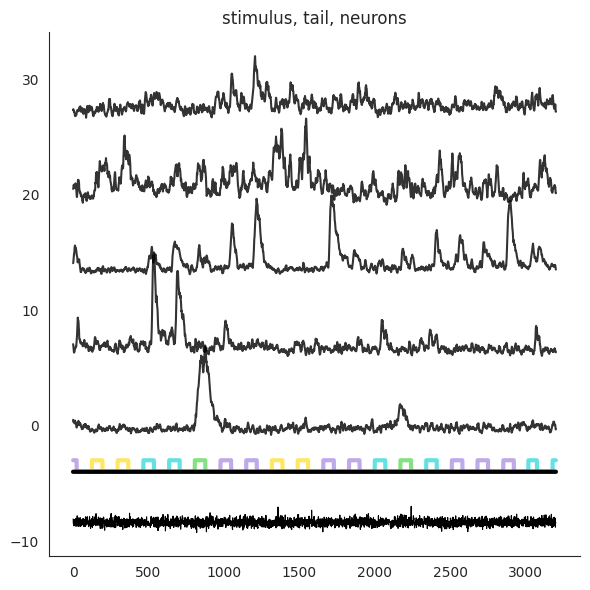

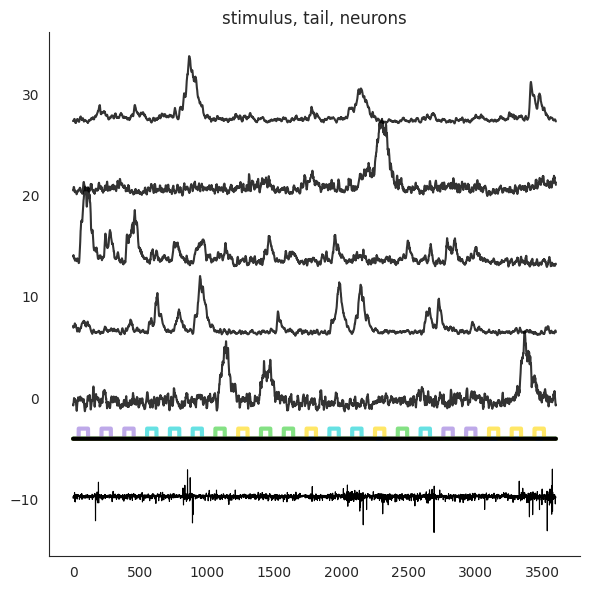

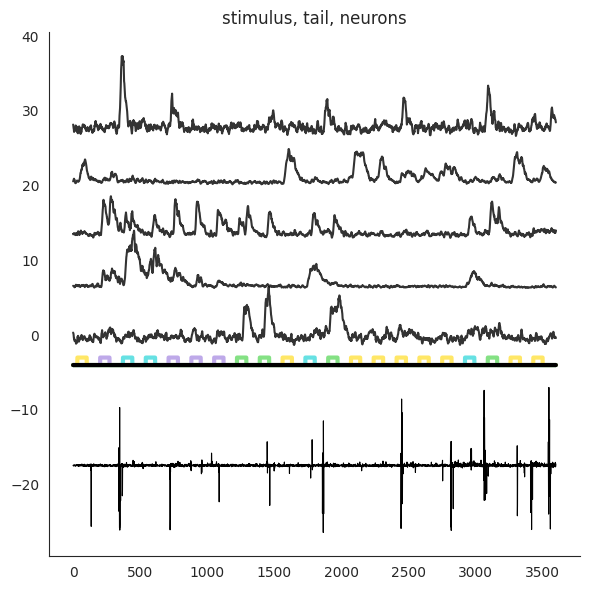

...

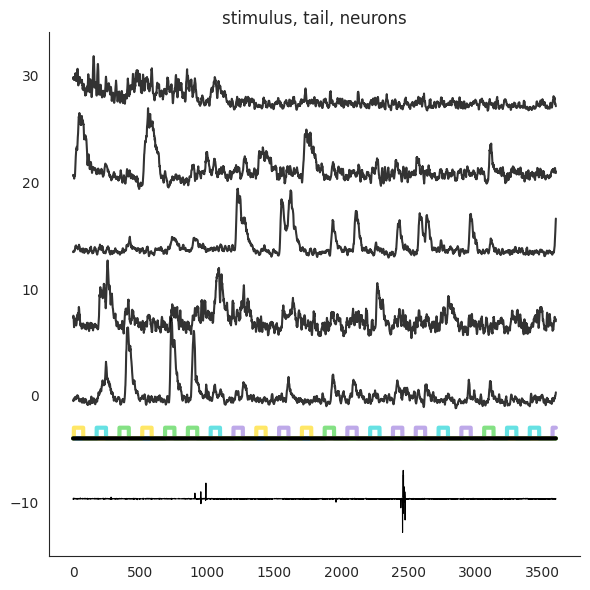

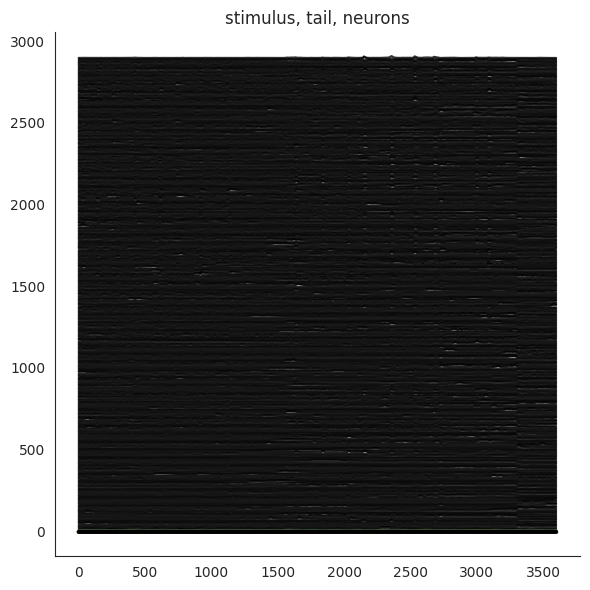

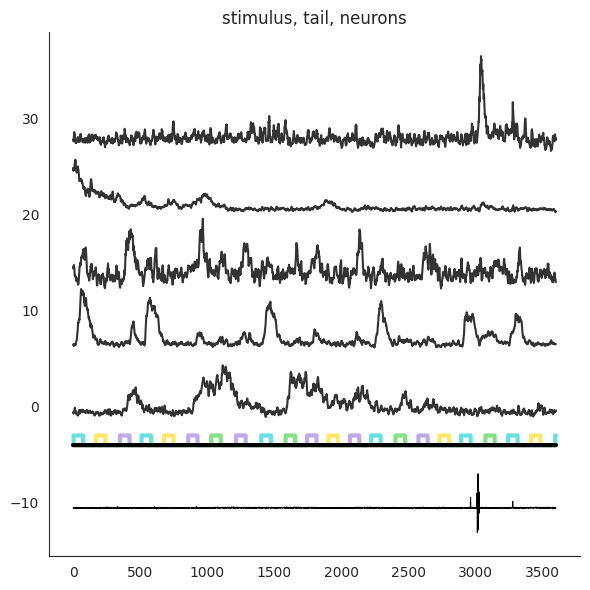

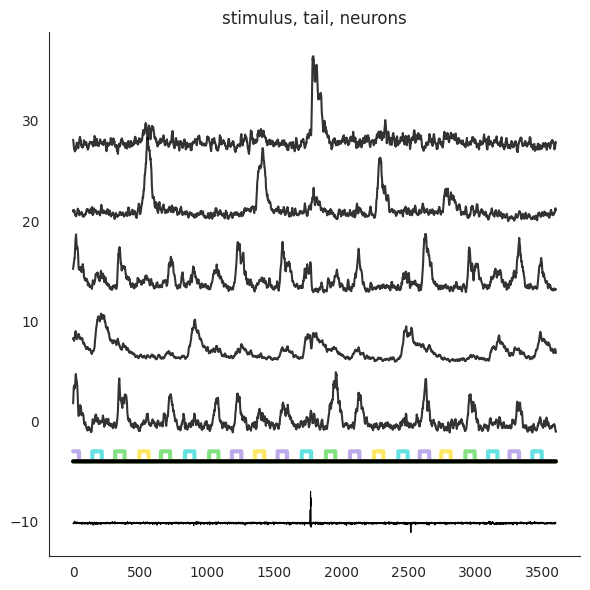

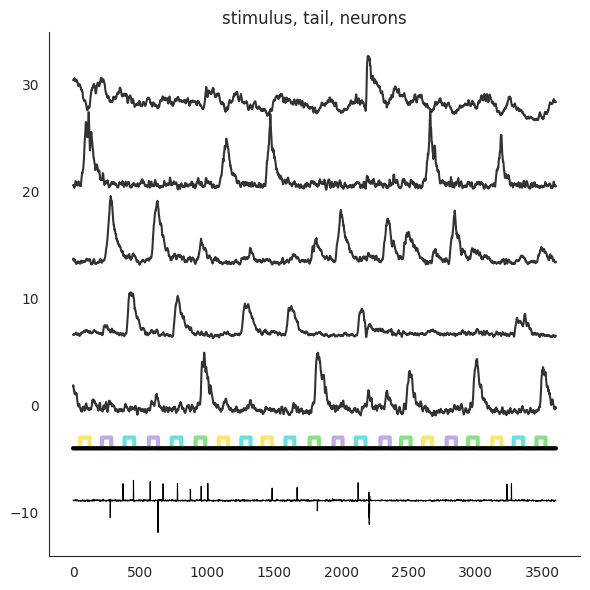

In [ ]:
wk2_subjects = [
'DZ-230518_wk2_f1_z-130_schooling',
'DZ-230605-f3-100_2wk_schooling',
'ml-230427-f4_schooling-3',
'DZ-230517_wk2_f2-2_schooling',
]

wk4_subjects=[
'DZ-230503_wk4_f1_schooling',
'DZ-230519_wk4_f1-2_schooling',
'DZ-230523_wk4_f2_-140_schooling',
'DZ-230427_wk4_f1_schooling',
]

wk6_subjects=[
'DZ-230522_wk6_f3_schooling',
'DZ-230522_wk6_f2_schooling',
'DZ-230521_wk6_f4_schooling',
'DZ-230529_wk6_f1_-160_schooling',
]

subjects = wk2_subjects+wk4_subjects+wk6_subjects


brain_regions = ['dorsal_forebrain', 'ventral_forebrain', 'habenula','thalamus',\
                 'left_tectum_neuropil', 'left_tectum_cell-layer',\
                 'right_tectum_neuropil', 'right_tectum_cell-layer',\
                 'cerebellum', 'hindbrain']

brain_region_groupings = [['telencephalon', 'dorsal_forebrain', 'ventral_forebrain'],\
                          ['dienencephalon', 'habenula','thalamus'],\
                          ['mesencephalon', 'left_tectum_neuropil', 'left_tectum_cell-layer','right_tectum_neuropil', 'right_tectum_cell-layer'],\
                          ['rhombencephalon', 'cerebellum', 'hindbrain']]


resample_Hz = 10 #define common Hz to resample all
ts_fraction = [0.05,1.0] #fraction of full timeseries to use

for f in subjects:
    path = '/content/drive/MyDrive/Zada_Schulze_paper/Imaging_data/Schooling/'+f+'/'

    #load processed imaging data
    load = np.load(path+'neuron_details_with-anatomy.npz', allow_pickle=True)
    tr=load['neuron_traces']


    load=np.load(path+'movement_stats.npz', allow_pickle=True)
    tmp=load['time_sec']
    time=[i-tmp[0] for i in tmp]
    new_time_base = int(max(time)*resample_Hz)
    tail_angle=resized(load['angle'],new_time_base)
    stimulus=load['stim']

    load=np.load(path+'linear_model_outputs_ridge.npz', allow_pickle=True)
    pred_scores=load['pred_scores']
    weight_set=load['weight_set']
    basis_functions=load['basis_functions']

    s0=np.zeros(len(stimulus));
    s1=np.zeros(len(stimulus));
    s2=np.zeros(len(stimulus));
    s3=np.zeros(len(stimulus));
    s4=np.zeros(len(stimulus));

    for ndx,i in enumerate(stimulus):
      if i==0:
        s0[ndx]=1
      if i==1:
        s1[ndx]=1
      if i==2:
        s2[ndx]=1
      if i==3:
        s3[ndx]=1
      if i==4:
        s4[ndx]=1

    #resample all to common Hz, and crop to first X% of behavior
    S1=resized(s1,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
    S2=resized(s2,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
    S3=resized(s3,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
    S4=resized(s4,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
    MOV=resized(turn_array,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
    tail_angle2 = tail_angle[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]

    #handle fluorescence traces here
    neuron_traces__=[]
    for i in tr:
      tmp = resized(i,new_time_base)[int(new_time_base*ts_fraction[0]):int(new_time_base*ts_fraction[1])]
      kernel_size = int(1.0*resample_Hz) #1s
      kernel = np.ones(kernel_size) / kernel_size
      tmp3 = np.convolve(tmp, kernel, mode='same') #smooth
      tmp3[0]=tmp3[1]; tmp3[-1]=tmp3[-2]
      neuron_traces__.append(scipy.stats.zscore(tmp3)) #append zscore

    plt.figure(figsize=[6,6])
    plt.tight_layout(pad=3.0)
    st=1200;ed=4800;
    examplecount=0
    for ndx in range(5):
      for w,tr in zip(weight_set[ndx],neuron_traces__):
        if w[0]==max([w[0] for w in weight_set[ndx]]):
          plt.plot(tr[st:ed] + examplecount*7, color='k', linewidth=1.5, alpha=0.8)
          examplecount+=1

    plt.plot(S1[st:ed]-4, color='limegreen', linewidth=3.0, alpha=0.6)
    plt.plot(S2[st:ed]-4, color='darkturquoise', linewidth=3.0, alpha=0.6)
    plt.plot(S3[st:ed]-4, color='mediumpurple', linewidth=3.0, alpha=0.6)
    plt.plot(S4[st:ed]-4, color='gold', linewidth=3.0, alpha=0.6)
    #plt.plot(np.zeros(len(S4[st:ed]))-4, color='k', linewidth=3.0)
    plt.plot((tail_angle2[st:ed]/10)-max(tail_angle2[st:ed]/10)-5, color='k', linewidth=0.8)
    plt.title('stimulus, tail, neurons')
    plt.tight_layout()
    plt.savefig(figure_savepath +"Basic_processing/Example_tuned_neurons"+f+".pdf", transparent=True)
    sns.despine()
    plt.show()